In [1]:
%matplotlib inline

import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

from config import cfg_seed, cfg_env, cfg_z_dim, cfg_default_lr, cfg_default_early
seed = cfg_seed
env_str=cfg_env
default_lr=cfg_default_lr
default_early=cfg_default_early

from config import cfg_alpha
alpha=cfg_alpha

num_iter_max=200000
env_name = 'CustomPendulum-v0'
env_str=cfg_env
figfilenamehead = "fig_policy_optimization_"+env_str+"_iter1_"

loss_list = []
normalized_loss_list = []

print("alpha",alpha)
print(datetime.datetime.now())

alpha 0.1
2023-06-12 06:41:52.990742


In [2]:
import gym
import custom_gym
env = gym.make(env_name)

np.random.seed(seed)
random.seed(seed)
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = cfg_z_dim
print(s_dim, a_dim, z_dim)



2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
# agent = SAC(env.observation_space.shape[0], env.action_space)
agent = SAC(env.observation_space.shape[0]+z_dim*2, env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_"+env_str+"_bamdp_standardvae_")


offline_data = pickle.load(open("offline_data_"+env_str+".pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info_"+env_str+".pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_bamdp_standardvae_


In [4]:
args_init_dict = {
    "offline_data": offline_data,
    "s_dim": s_dim,
    "a_dim": a_dim,
    "z_dim": z_dim,
    #              "policy":agent.select_action,
    "mdp_policy":None,
    "bamdp_policy":agent.policy.my_np_select_action,
    "debug_info":debug_info,
    "env" : env,
    "ckpt_suffix" : env_str,
}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base(ckpt_key="unweighted")
# iwvi.update_mulogvar_offlinedata()

dec: h_dim 48
base load ckpt ckpt_basevi_pendulum_unweighted
base load self.initial_belief.data.sum() tensor(-5.5968)
base load dec.state_dict()['net_phat.0.weight'].sum() tensor(1.4496)
penalty_target_min tensor(-5.5859) penalty_target_max tensor(160.8683)
train_loss:  -3.890300930738449
valid_loss:  -3.563665451002121
h_min_tilde -5.5858636 ell_tilde -3.824973834791183 kappa_tilde 0.0007535879000184934


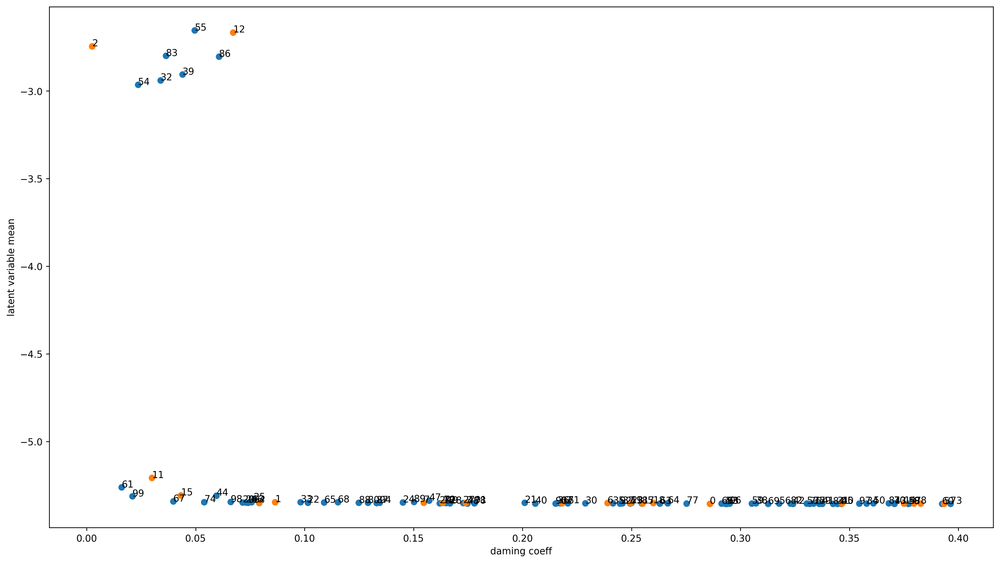

[0.2859264  0.0864358  0.0024921  0.17391661 0.07907403 0.39336027
 0.23893358 0.15462851 0.38266119 0.37959092]
[0.34651572 0.02997943 0.06718887 0.16337754 0.37502863 0.04327735
 0.21808106 0.2550441  0.25992204 0.24956645]
[0.07158956 0.20101322 0.10147186 0.24997234 0.14514144 0.07657856
 0.07297816 0.17272883 0.16671052 0.16193009]
[0.22885551 0.34440572 0.03386464 0.09818148 0.35786052 0.2414254
 0.21602989 0.24582514 0.30710321 0.04392725]
[0.20586148 0.3374828  0.32405777 0.37068828 0.05949074 0.34630997
 0.0756103  0.15711247 0.17470652 0.16498888]
[0.36096874 0.24942754 0.29319949 0.33040915 0.02355204 0.04960585
 0.31776933 0.377519   0.37703434 0.30519746]
[0.39248397 0.01603645 0.21731613 0.26299385 0.26662336 0.10898858
 0.29130778 0.03973111 0.11521473 0.31261245]
[0.37032344 0.22077058 0.16383656 0.39631873 0.05390104 0.33351255
 0.33176718 0.27528851 0.17781627 0.33618643]
[0.12902999 0.36799494 0.32301958 0.03636422 0.34247351 0.25473947
 0.06075424 0.13299807 0.12488

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.eps")
# plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_bamdppolicy_data()


 0 1.6689300537109375e-06


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ


 1 5.005066156387329

 2 4.2609779834747314

 3 4.0815582275390625

 4 3.7069954872131348

 5 3.4325101375579834

 6 3.185065746307373

 7 3.3334171772003174

 8 4.0730133056640625

 9 3.5941708087921143

 10 3.0765726566314697

 11 3.519921064376831

 12 3.889089584350586

 13 3.771584987640381

 14 4.730503797531128

 15 3.7267770767211914

 16 3.2852120399475098

 17 3.5333077907562256

 18 4.022031545639038

 19 4.043458461761475

 20 4.017788648605347

 21 3.3319334983825684

 22 3.267526626586914

 23 3.4090681076049805

 24 4.44287371635437

 25 3.7490148544311523

 26 3.6000022888183594

 27 3.9582574367523193

 28 3.618429183959961

 29 3.6738529205322266

 30 3.643282890319824

 31 3.6079561710357666

 32 3.5573925971984863

 33 4.07825779914856

 34 7.925026178359985

 35 4.993872404098511

 36 4.6036460399627686

 37 3.764545202255249

 38 3.8060367107391357

 39 5.615391731262207

 40 7.1616737842559814

 41 5.238065719604492

 42 7.237395286560059

 43 4.728279113769531


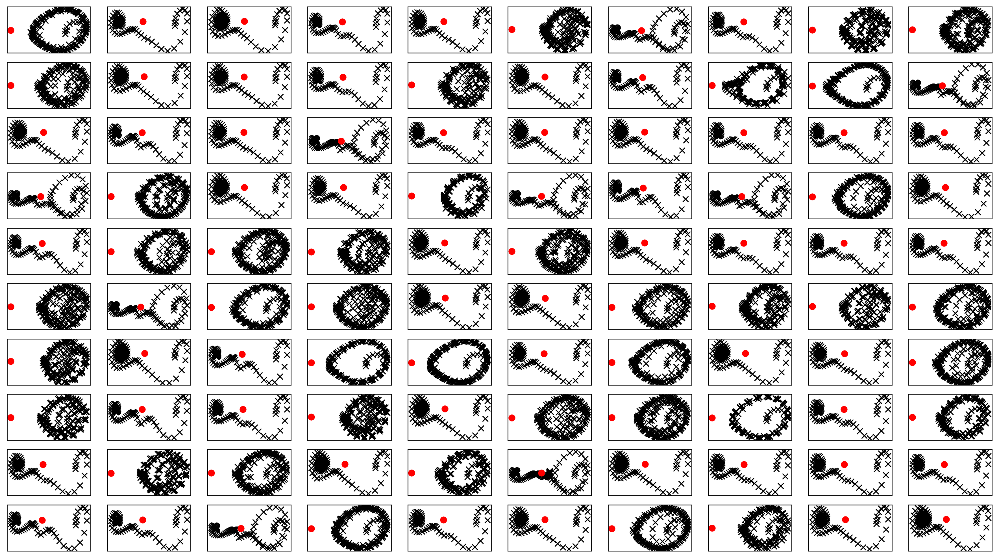

In [7]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx")
    ax_list[-1].plot(0, 0,"ro") 
plt.show()

In [8]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)

実環境方策rollout vs Sim環境方策rollout


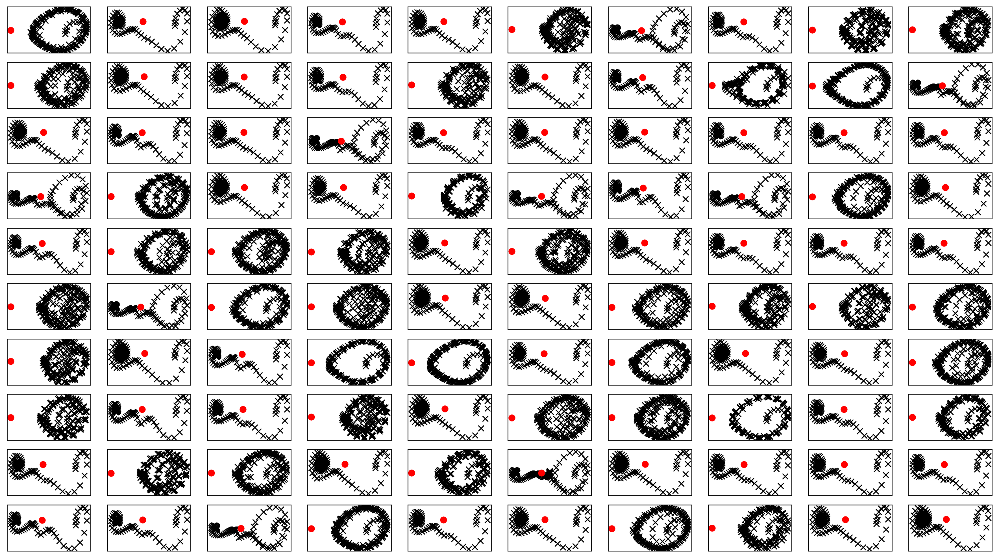

In [9]:


fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1])
    
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 

plt.savefig(figfilenamehead+"iter0.png")
# plt.savefig(figfilenamehead+"iter0.pdf")
plt.savefig(figfilenamehead+"iter0.eps")
print("実環境方策rollout vs Sim環境方策rollout")

In [10]:
print(datetime.datetime.now())

2023-06-12 06:49:48.132755


# Iter 1

In [11]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [12]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 1.22692  validloss 1.40865±0.00000  bestvalidloss 1.40865  last_update 0
train: iter 1  trainloss 0.82986  validloss 0.93242±0.00000  bestvalidloss 0.93242  last_update 0
train: iter 2  trainloss 0.73464  validloss 0.73150±0.00000  bestvalidloss 0.73150  last_update 0
train: iter 3  trainloss 0.69471  validloss 0.67561±0.00000  bestvalidloss 0.67561  last_update 0
train: iter 4  trainloss 0.66565  validloss 0.63766±0.00000  bestvalidloss 0.63766  last_update 0
train: iter 5  trainloss 0.64328  validloss 0.60815±0.00000  bestvalidloss 0.60815  last_update 0
train: iter 6  trainloss 0.62156  validloss 0.59019±0.00000  bestvalidloss 0.59019  last_update 0
train: iter 7  trainloss 0.60180  validloss 0.56093±0.00000  bestvalidloss 0.56093  last_update 0
train: iter 8  trainloss 0.58283  validloss 0.54055±0.00000  bestvalidloss 0.54055  last_update 0
train: iter 9  trainloss 0.56344  validloss 0.52516±0.00000  bestvalidloss 0.52516  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.44413  validloss 0.40536±0.00000  bestvalidloss 0.39831  last_update 4
train: iter 84  trainloss 0.44004  validloss 0.40299±0.00000  bestvalidloss 0.39831  last_update 5
train: iter 85  trainloss 0.44777  validloss 0.40706±0.00000  bestvalidloss 0.39831  last_update 6
train: iter 86  trainloss 0.43729  validloss 0.41214±0.00000  bestvalidloss 0.39831  last_update 7
train: iter 87  trainloss 0.44111  validloss 0.40619±0.00000  bestvalidloss 0.39831  last_update 8
train: iter 88  trainloss 0.43808  validloss 0.42071±0.00000  bestvalidloss 0.39831  last_update 9
train: iter 89  trainloss 0.44287  validloss 0.41629±0.00000  bestvalidloss 0.39831  last_update 10
train: iter 90  trainloss 0.44080  validloss 0.43363±0.00000  bestvalidloss 0.39831  last_update 11
train: iter 91  trainloss 0.43971  validloss 0.41023±0.00000  bestvalidloss 0.39831  last_update 12
train: iter 92  trainloss 0.43506  validloss 0.40130±0.00000  bestvalidloss 0.39831  last_update 13
train:

train: iter 165  trainloss 0.42965  validloss 0.39265±0.00000  bestvalidloss 0.38304  last_update 16
train: iter 166  trainloss 0.42883  validloss 0.42564±0.00000  bestvalidloss 0.38304  last_update 17
train: iter 167  trainloss 0.42234  validloss 0.42591±0.00000  bestvalidloss 0.38304  last_update 18
train: iter 168  trainloss 0.43001  validloss 0.39591±0.00000  bestvalidloss 0.38304  last_update 19
train: iter 169  trainloss 0.42529  validloss 0.44555±0.00000  bestvalidloss 0.38304  last_update 20
train: iter 170  trainloss 0.42366  validloss 0.41030±0.00000  bestvalidloss 0.38304  last_update 21
train: iter 171  trainloss 0.42441  validloss 0.39327±0.00000  bestvalidloss 0.38304  last_update 22
train: iter 172  trainloss 0.42201  validloss 0.40302±0.00000  bestvalidloss 0.38304  last_update 23
train: iter 173  trainloss 0.42300  validloss 0.43254±0.00000  bestvalidloss 0.38304  last_update 24
train: iter 174  trainloss 0.42363  validloss 0.38469±0.00000  bestvalidloss 0.38304  last_

train: iter 247  trainloss 0.38564  validloss 0.37391±0.00000  bestvalidloss 0.37391  last_update 0
train: iter 248  trainloss 0.38952  validloss 0.38006±0.00000  bestvalidloss 0.37391  last_update 1
train: iter 249  trainloss 0.38822  validloss 0.39280±0.00000  bestvalidloss 0.37391  last_update 2
train: iter 250  trainloss 0.38611  validloss 0.37931±0.00000  bestvalidloss 0.37391  last_update 3
train: iter 251  trainloss 0.38804  validloss 0.39196±0.00000  bestvalidloss 0.37391  last_update 4
train: iter 252  trainloss 0.38751  validloss 0.38813±0.00000  bestvalidloss 0.37391  last_update 5
train: iter 253  trainloss 0.38644  validloss 0.38951±0.00000  bestvalidloss 0.37391  last_update 6
train: iter 254  trainloss 0.38600  validloss 0.37746±0.00000  bestvalidloss 0.37391  last_update 7
train: iter 255  trainloss 0.38778  validloss 0.37949±0.00000  bestvalidloss 0.37391  last_update 8
train: iter 256  trainloss 0.38857  validloss 0.37940±0.00000  bestvalidloss 0.37391  last_update 9


train: iter 329  trainloss 0.37271  validloss 0.38732±0.00000  bestvalidloss 0.36648  last_update 32
train: iter 330  trainloss 0.37357  validloss 0.37149±0.00000  bestvalidloss 0.36648  last_update 33
train: iter 331  trainloss 0.37257  validloss 0.38733±0.00000  bestvalidloss 0.36648  last_update 34
train: iter 332  trainloss 0.37379  validloss 0.43670±0.00000  bestvalidloss 0.36648  last_update 35
train: iter 333  trainloss 0.37607  validloss 0.39074±0.00000  bestvalidloss 0.36648  last_update 36
train: iter 334  trainloss 0.38002  validloss 0.38286±0.00000  bestvalidloss 0.36648  last_update 37
train: iter 335  trainloss 0.37290  validloss 0.39211±0.00000  bestvalidloss 0.36648  last_update 38
train: iter 336  trainloss 0.37211  validloss 0.37857±0.00000  bestvalidloss 0.36648  last_update 39
train: iter 337  trainloss 0.37258  validloss 0.37263±0.00000  bestvalidloss 0.36648  last_update 40
train: iter 338  trainloss 0.37193  validloss 0.40354±0.00000  bestvalidloss 0.36648  last_

train: iter 411  trainloss 0.36532  validloss 0.37915±0.00000  bestvalidloss 0.36500  last_update 33
train: iter 412  trainloss 0.36911  validloss 0.38590±0.00000  bestvalidloss 0.36500  last_update 34
train: iter 413  trainloss 0.36645  validloss 0.37366±0.00000  bestvalidloss 0.36500  last_update 35
train: iter 414  trainloss 0.36853  validloss 0.37898±0.00000  bestvalidloss 0.36500  last_update 36
train: iter 415  trainloss 0.36651  validloss 0.37238±0.00000  bestvalidloss 0.36500  last_update 37
train: iter 416  trainloss 0.36649  validloss 0.37685±0.00000  bestvalidloss 0.36500  last_update 38
train: iter 417  trainloss 0.36476  validloss 0.36960±0.00000  bestvalidloss 0.36500  last_update 39
train: iter 418  trainloss 0.36444  validloss 0.37499±0.00000  bestvalidloss 0.36500  last_update 40
train: iter 419  trainloss 0.36514  validloss 0.36411±0.00000  bestvalidloss 0.36411  last_update 0
train: iter 420  trainloss 0.36882  validloss 0.39089±0.00000  bestvalidloss 0.36411  last_u

train: iter 493  trainloss 0.36300  validloss 0.36547±0.00000  bestvalidloss 0.36411  last_update 74
train: iter 494  trainloss 0.36307  validloss 0.37388±0.00000  bestvalidloss 0.36411  last_update 75
train: iter 495  trainloss 0.36481  validloss 0.36861±0.00000  bestvalidloss 0.36411  last_update 76
train: iter 496  trainloss 0.36225  validloss 0.36653±0.00000  bestvalidloss 0.36411  last_update 77
train: iter 497  trainloss 0.36519  validloss 0.38551±0.00000  bestvalidloss 0.36411  last_update 78
train: iter 498  trainloss 0.36123  validloss 0.38570±0.00000  bestvalidloss 0.36411  last_update 79
train: iter 499  trainloss 0.36550  validloss 0.37326±0.00000  bestvalidloss 0.36411  last_update 80
train: iter 500  trainloss 0.36212  validloss 0.36419±0.00000  bestvalidloss 0.36411  last_update 81
train: iter 501  trainloss 0.36343  validloss 0.36584±0.00000  bestvalidloss 0.36411  last_update 82
train: iter 502  trainloss 0.36325  validloss 0.38852±0.00000  bestvalidloss 0.36411  last_

([1.226920049637556,
  0.8298600658774375,
  0.7346422053873539,
  0.6947060838341713,
  0.6656523782759904,
  0.6432791527360677,
  0.6215569473803043,
  0.6018015280365944,
  0.582831260561943,
  0.5634416937828064,
  0.548300527781248,
  0.5412861291319132,
  0.5239590190351009,
  0.5125342160463333,
  0.5042973909527063,
  0.5003254517912865,
  0.49714270159602164,
  0.4930195014923811,
  0.4888132281601429,
  0.5016789332032203,
  0.4781387630850077,
  0.47483932189643385,
  0.47355191707611083,
  0.47234030850231645,
  0.47276703380048274,
  0.4761118609458208,
  0.46559738665819167,
  0.464197064563632,
  0.4689054798334837,
  0.46719852425158026,
  0.4598399350419641,
  0.4797100007534027,
  0.4666663287207484,
  0.461800299026072,
  0.4612793421372771,
  0.45873300097882747,
  0.4604222562164068,
  0.45855972319841387,
  0.4601471159607172,
  0.45519740879535675,
  0.4572154998779297,
  0.45473371986299754,
  0.45070235095918176,
  0.45366169009357693,
  0.4602577878162265,
  

In [13]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -0.55527908821702
valid_loss:  0.4076753160595894
weight_alpha 1.0 h_min_tilde -5.5858636 ell_tilde -0.36268820736169816 kappa_tilde 0.0004375550450146707
train_loss:  -2.839445871949196
valid_loss:  -2.5613504901885986
weight_alpha 0.1 h_min_tilde -5.5858636 ell_tilde -2.7838267955970766 kappa_tilde 0.0005973970628922937


1e-08 1000.0


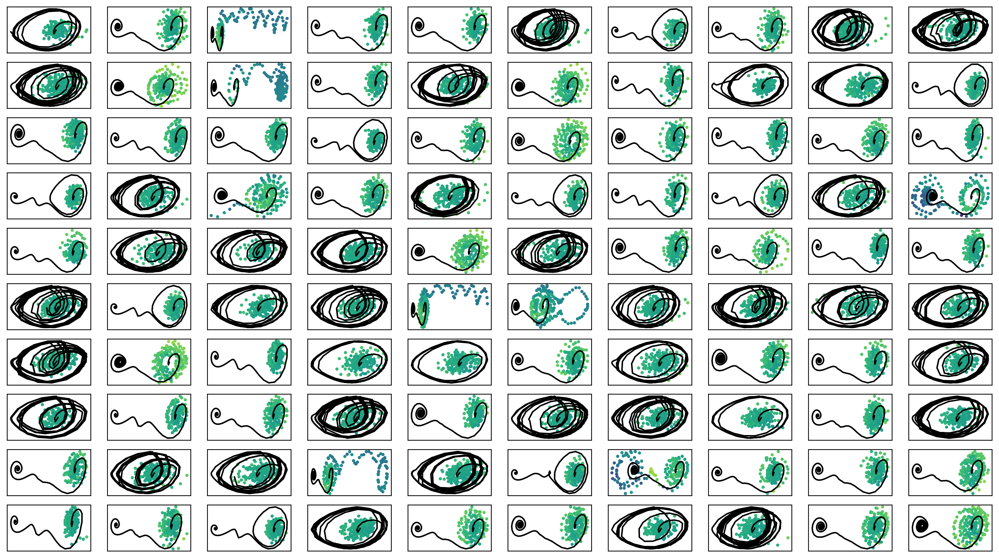

In [14]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [15]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=default_early, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=default_early, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -527.77710  validloss -512.87416±0.00000  bestvalidloss -512.87416  last_update 0
train: iter 1  trainloss -541.06180  validloss -491.49727±0.00000  bestvalidloss -512.87416  last_update 1
train: iter 2  trainloss -508.84983  validloss -501.36801±0.00000  bestvalidloss -512.87416  last_update 2
train: iter 3  trainloss -537.94599  validloss -491.99394±0.00000  bestvalidloss -512.87416  last_update 3
train: iter 4  trainloss -550.78112  validloss -505.91591±0.00000  bestvalidloss -512.87416  last_update 4
train: iter 5  trainloss -541.70101  validloss -502.93829±0.00000  bestvalidloss -512.87416  last_update 5
train: iter 6  trainloss -547.14855  validloss -415.23858±0.00000  bestvalidloss -512.87416  last_update 6
train: iter 7  trainloss -547.58833  validloss -477.84539±0.00000  bestvalidloss -512.87416  last_update 7
train: iter 8  trainloss -553.61735  validloss -475.14140±0.00000  bestvalidloss -512.87416  last_u

train: iter 76  trainloss -564.11614  validloss -446.56430±0.00000  bestvalidloss -521.16552  last_update 6
train: iter 77  trainloss -564.93475  validloss -492.65833±0.00000  bestvalidloss -521.16552  last_update 7
train: iter 78  trainloss -564.70924  validloss -518.13951±0.00000  bestvalidloss -521.16552  last_update 8
train: iter 79  trainloss -545.99302  validloss 67.64060±0.00000  bestvalidloss -521.16552  last_update 9
train: iter 80  trainloss -545.27432  validloss -505.47744±0.00000  bestvalidloss -521.16552  last_update 10
train: iter 81  trainloss -555.23631  validloss -508.46269±0.00000  bestvalidloss -521.16552  last_update 11
train: iter 82  trainloss -544.35084  validloss -505.02923±0.00000  bestvalidloss -521.16552  last_update 12
train: iter 83  trainloss -573.51205  validloss -515.61298±0.00000  bestvalidloss -521.16552  last_update 13
train: iter 84  trainloss -559.12212  validloss -501.77917±0.00000  bestvalidloss -521.16552  last_update 14
train: iter 85  trainloss

train: iter 151  trainloss -584.47789  validloss -455.06982±0.00000  bestvalidloss -522.54377  last_update 13
train: iter 152  trainloss -590.66353  validloss -472.69555±0.00000  bestvalidloss -522.54377  last_update 14
train: iter 153  trainloss -588.22874  validloss -467.23821±0.00000  bestvalidloss -522.54377  last_update 15
train: iter 154  trainloss -600.06968  validloss -419.46710±0.00000  bestvalidloss -522.54377  last_update 16
train: iter 155  trainloss -569.30998  validloss -467.01006±0.00000  bestvalidloss -522.54377  last_update 17
train: iter 156  trainloss -585.33095  validloss -461.11637±0.00000  bestvalidloss -522.54377  last_update 18
train: iter 157  trainloss -589.60287  validloss -457.46000±0.00000  bestvalidloss -522.54377  last_update 19
train: iter 158  trainloss -583.97456  validloss -510.36341±0.00000  bestvalidloss -522.54377  last_update 20
train: iter 159  trainloss -577.50060  validloss 3782.72797±0.00000  bestvalidloss -522.54377  last_update 21
train: ite

train: iter 226  trainloss -614.33983  validloss -376.69783±0.00000  bestvalidloss -552.13809  last_update 2
train: iter 227  trainloss -621.07440  validloss -494.50372±0.00000  bestvalidloss -552.13809  last_update 3
train: iter 228  trainloss -622.20278  validloss -540.40472±0.00000  bestvalidloss -552.13809  last_update 4
train: iter 229  trainloss -607.93628  validloss -545.01512±0.00000  bestvalidloss -552.13809  last_update 5
train: iter 230  trainloss -607.16891  validloss -544.97249±0.00000  bestvalidloss -552.13809  last_update 6
train: iter 231  trainloss -622.36644  validloss -246.42774±0.00000  bestvalidloss -552.13809  last_update 7
train: iter 232  trainloss -611.57976  validloss -458.26250±0.00000  bestvalidloss -552.13809  last_update 8
train: iter 233  trainloss -626.94327  validloss -226.55486±0.00000  bestvalidloss -552.13809  last_update 9
train: iter 234  trainloss -615.48616  validloss -519.52510±0.00000  bestvalidloss -552.13809  last_update 10
train: iter 235  t

train: iter 302  trainloss -690.29542  validloss -99.28172±0.00000  bestvalidloss -641.31687  last_update 2
train: iter 303  trainloss -671.05340  validloss -635.83375±0.00000  bestvalidloss -641.31687  last_update 3
train: iter 304  trainloss -682.75495  validloss -542.95821±0.00000  bestvalidloss -641.31687  last_update 4
train: iter 305  trainloss -680.52373  validloss -617.94951±0.00000  bestvalidloss -641.31687  last_update 5
train: iter 306  trainloss -692.74635  validloss -640.44705±0.00000  bestvalidloss -641.31687  last_update 6
train: iter 307  trainloss -692.98989  validloss -640.26784±0.00000  bestvalidloss -641.31687  last_update 7
train: iter 308  trainloss -691.33104  validloss -631.93593±0.00000  bestvalidloss -641.31687  last_update 8
train: iter 309  trainloss -688.04627  validloss -631.74291±0.00000  bestvalidloss -641.31687  last_update 9
train: iter 310  trainloss -704.62964  validloss -638.11818±0.00000  bestvalidloss -641.31687  last_update 10
train: iter 311  tr

train: iter 378  trainloss -741.82645  validloss -687.38080±0.00000  bestvalidloss -714.21356  last_update 6
train: iter 379  trainloss -755.38370  validloss -692.06048±0.00000  bestvalidloss -714.21356  last_update 7
train: iter 380  trainloss -761.54512  validloss -665.56938±0.00000  bestvalidloss -714.21356  last_update 8
train: iter 381  trainloss -745.87747  validloss -710.47499±0.00000  bestvalidloss -714.21356  last_update 9
train: iter 382  trainloss -765.66098  validloss -692.08239±0.00000  bestvalidloss -714.21356  last_update 10
train: iter 383  trainloss -766.52587  validloss -715.59575±0.00000  bestvalidloss -715.59575  last_update 0
train: iter 384  trainloss -767.43662  validloss -703.20264±0.00000  bestvalidloss -715.59575  last_update 1
train: iter 385  trainloss -744.87992  validloss -675.27638±0.00000  bestvalidloss -715.59575  last_update 2
train: iter 386  trainloss -779.19747  validloss -718.72522±0.00000  bestvalidloss -718.72522  last_update 0
train: iter 387  t

train: iter 454  trainloss -791.22071  validloss -635.04617±0.00000  bestvalidloss -757.21365  last_update 3
train: iter 455  trainloss -809.19767  validloss -752.35174±0.00000  bestvalidloss -757.21365  last_update 4
train: iter 456  trainloss -801.84286  validloss -735.57352±0.00000  bestvalidloss -757.21365  last_update 5
train: iter 457  trainloss -805.25801  validloss -692.91096±0.00000  bestvalidloss -757.21365  last_update 6
train: iter 458  trainloss -799.23119  validloss -710.31765±0.00000  bestvalidloss -757.21365  last_update 7
train: iter 459  trainloss -798.14212  validloss -694.78099±0.00000  bestvalidloss -757.21365  last_update 8
train: iter 460  trainloss -802.03278  validloss -731.03267±0.00000  bestvalidloss -757.21365  last_update 9
train: iter 461  trainloss -780.03935  validloss -673.25151±0.00000  bestvalidloss -757.21365  last_update 10
train: iter 462  trainloss -786.15664  validloss -756.45815±0.00000  bestvalidloss -757.21365  last_update 11
train: iter 463  

train: iter 529  trainloss -832.37597  validloss -770.62899±0.00000  bestvalidloss -783.75078  last_update 1
train: iter 530  trainloss -818.74542  validloss -774.11429±0.00000  bestvalidloss -783.75078  last_update 2
train: iter 531  trainloss -829.88501  validloss -745.96827±0.00000  bestvalidloss -783.75078  last_update 3
train: iter 532  trainloss -837.37500  validloss -745.83517±0.00000  bestvalidloss -783.75078  last_update 4
train: iter 533  trainloss -807.74034  validloss -769.62935±0.00000  bestvalidloss -783.75078  last_update 5
train: iter 534  trainloss -824.04603  validloss -726.08313±0.00000  bestvalidloss -783.75078  last_update 6
train: iter 535  trainloss -825.53967  validloss -786.72763±0.00000  bestvalidloss -786.72763  last_update 0
train: iter 536  trainloss -836.00274  validloss -737.66569±0.00000  bestvalidloss -786.72763  last_update 1
train: iter 537  trainloss -832.36217  validloss -698.75440±0.00000  bestvalidloss -786.72763  last_update 2
train: iter 538  tr

train: iter 604  trainloss -848.64149  validloss -664.98442±0.00000  bestvalidloss -800.35858  last_update 15
train: iter 605  trainloss -854.74499  validloss -736.29961±0.00000  bestvalidloss -800.35858  last_update 16
train: iter 606  trainloss -821.83447  validloss -775.98558±0.00000  bestvalidloss -800.35858  last_update 17
train: iter 607  trainloss -850.54830  validloss -779.12683±0.00000  bestvalidloss -800.35858  last_update 18
train: iter 608  trainloss -828.59181  validloss -796.32647±0.00000  bestvalidloss -800.35858  last_update 19
train: iter 609  trainloss -840.00249  validloss -764.50667±0.00000  bestvalidloss -800.35858  last_update 20
train: iter 610  trainloss -846.01621  validloss -704.65096±0.00000  bestvalidloss -800.35858  last_update 21
train: iter 611  trainloss -842.54875  validloss -774.21553±0.00000  bestvalidloss -800.35858  last_update 22
train: iter 612  trainloss -853.95810  validloss -785.04138±0.00000  bestvalidloss -800.35858  last_update 23
train: ite

train: iter 679  trainloss -876.42985  validloss -786.68909±0.00000  bestvalidloss -819.94841  last_update 6
train: iter 680  trainloss -829.06085  validloss -732.01254±0.00000  bestvalidloss -819.94841  last_update 7
train: iter 681  trainloss -879.69143  validloss -789.43299±0.00000  bestvalidloss -819.94841  last_update 8
train: iter 682  trainloss -835.20573  validloss -799.62788±0.00000  bestvalidloss -819.94841  last_update 9
train: iter 683  trainloss -848.83852  validloss -728.55340±0.00000  bestvalidloss -819.94841  last_update 10
train: iter 684  trainloss -853.86969  validloss -811.26759±0.00000  bestvalidloss -819.94841  last_update 11
train: iter 685  trainloss -870.88864  validloss -787.85403±0.00000  bestvalidloss -819.94841  last_update 12
train: iter 686  trainloss -843.02846  validloss -762.73614±0.00000  bestvalidloss -819.94841  last_update 13
train: iter 687  trainloss -857.66278  validloss -804.51212±0.00000  bestvalidloss -819.94841  last_update 14
train: iter 68

train: iter 754  trainloss -872.39049  validloss -807.05868±0.00000  bestvalidloss -830.91762  last_update 16
train: iter 755  trainloss -863.08940  validloss -816.04266±0.00000  bestvalidloss -830.91762  last_update 17
train: iter 756  trainloss -878.96080  validloss -810.04442±0.00000  bestvalidloss -830.91762  last_update 18
train: iter 757  trainloss -882.07882  validloss -814.42910±0.00000  bestvalidloss -830.91762  last_update 19
train: iter 758  trainloss -870.36105  validloss -809.75958±0.00000  bestvalidloss -830.91762  last_update 20
train: iter 759  trainloss -884.17440  validloss -824.45690±0.00000  bestvalidloss -830.91762  last_update 21
train: iter 760  trainloss -893.61171  validloss -809.48566±0.00000  bestvalidloss -830.91762  last_update 22
train: iter 761  trainloss -889.39774  validloss -811.98908±0.00000  bestvalidloss -830.91762  last_update 23
train: iter 762  trainloss -869.36702  validloss -753.71079±0.00000  bestvalidloss -830.91762  last_update 24
train: ite

train: iter 829  trainloss -884.44899  validloss -796.16103±0.00000  bestvalidloss -836.87750  last_update 58
train: iter 830  trainloss -867.38871  validloss -836.79250±0.00000  bestvalidloss -836.87750  last_update 59
train: iter 831  trainloss -861.69350  validloss -742.39894±0.00000  bestvalidloss -836.87750  last_update 60
train: iter 832  trainloss -865.00892  validloss -803.26519±0.00000  bestvalidloss -836.87750  last_update 61
train: iter 833  trainloss -873.01963  validloss -787.41848±0.00000  bestvalidloss -836.87750  last_update 62
train: iter 834  trainloss -868.92032  validloss -776.87009±0.00000  bestvalidloss -836.87750  last_update 63
train: iter 835  trainloss -889.94144  validloss -831.93305±0.00000  bestvalidloss -836.87750  last_update 64
train: iter 836  trainloss -870.57294  validloss -804.26652±0.00000  bestvalidloss -836.87750  last_update 65
train: iter 837  trainloss -854.72961  validloss -757.32353±0.00000  bestvalidloss -836.87750  last_update 66
train: ite

train: iter 904  trainloss -874.63361  validloss -775.36180±0.00000  bestvalidloss -841.13036  last_update 38
train: iter 905  trainloss -877.54085  validloss -830.54471±0.00000  bestvalidloss -841.13036  last_update 39
train: iter 906  trainloss -889.95490  validloss -834.63424±0.00000  bestvalidloss -841.13036  last_update 40
train: iter 907  trainloss -885.25997  validloss -806.61958±0.00000  bestvalidloss -841.13036  last_update 41
train: iter 908  trainloss -866.36091  validloss -819.90322±0.00000  bestvalidloss -841.13036  last_update 42
train: iter 909  trainloss -882.28464  validloss -837.96463±0.00000  bestvalidloss -841.13036  last_update 43
train: iter 910  trainloss -885.79740  validloss -728.81694±0.00000  bestvalidloss -841.13036  last_update 44
train: iter 911  trainloss -894.10410  validloss -825.32696±0.00000  bestvalidloss -841.13036  last_update 45
train: iter 912  trainloss -886.90326  validloss -816.34076±0.00000  bestvalidloss -841.13036  last_update 46
train: ite

train: iter 979  trainloss -864.03701  validloss -831.27861±0.00000  bestvalidloss -842.48143  last_update 62
train: iter 980  trainloss -855.62969  validloss -650.76214±0.00000  bestvalidloss -842.48143  last_update 63
train: iter 981  trainloss -854.59911  validloss -836.59437±0.00000  bestvalidloss -842.48143  last_update 64
train: iter 982  trainloss -887.61449  validloss -820.55016±0.00000  bestvalidloss -842.48143  last_update 65
train: iter 983  trainloss -876.55840  validloss -814.54223±0.00000  bestvalidloss -842.48143  last_update 66
train: iter 984  trainloss -891.90010  validloss -835.91171±0.00000  bestvalidloss -842.48143  last_update 67
train: iter 985  trainloss -889.02972  validloss -802.29328±0.00000  bestvalidloss -842.48143  last_update 68
train: iter 986  trainloss -874.96995  validloss -843.37778±0.00000  bestvalidloss -843.37778  last_update 0
train: iter 987  trainloss -874.69469  validloss -802.78640±0.00000  bestvalidloss -843.37778  last_update 1
train: iter 

train: iter 1054  trainloss -883.06615  validloss -825.82671±0.00000  bestvalidloss -843.37778  last_update 68
train: iter 1055  trainloss -900.67013  validloss -813.59203±0.00000  bestvalidloss -843.37778  last_update 69
train: iter 1056  trainloss -898.83850  validloss -793.26248±0.00000  bestvalidloss -843.37778  last_update 70
train: iter 1057  trainloss -889.36875  validloss -809.57994±0.00000  bestvalidloss -843.37778  last_update 71
train: iter 1058  trainloss -865.72735  validloss -792.75681±0.00000  bestvalidloss -843.37778  last_update 72
train: iter 1059  trainloss -893.80302  validloss -808.48168±0.00000  bestvalidloss -843.37778  last_update 73
train: iter 1060  trainloss -894.28047  validloss -792.55728±0.00000  bestvalidloss -843.37778  last_update 74
train: iter 1061  trainloss -868.41179  validloss -808.46131±0.00000  bestvalidloss -843.37778  last_update 75
train: iter 1062  trainloss -892.38317  validloss -827.63643±0.00000  bestvalidloss -843.37778  last_update 76
t

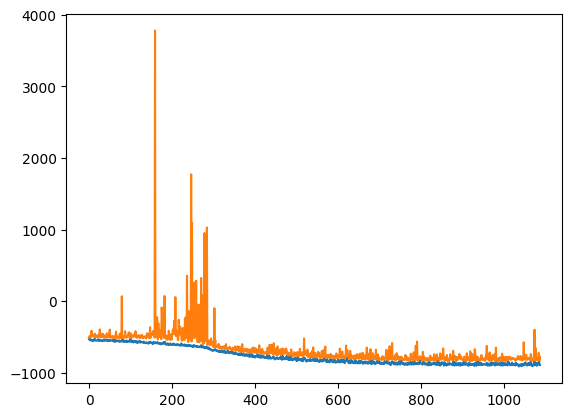

alpha 0.1 default_lr 0.0005


In [16]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

In [17]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)



実環境方策rollout vs Sim環境方策rollout


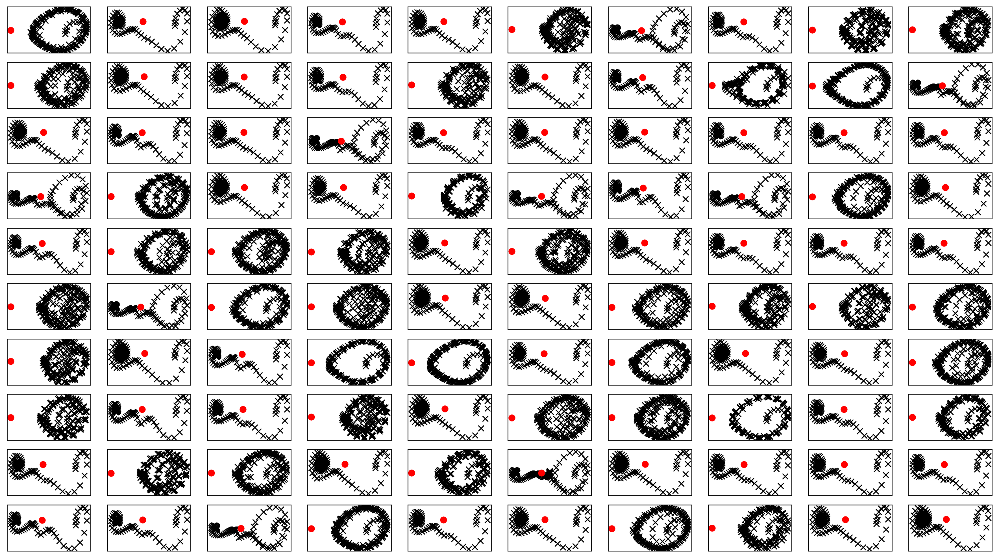

In [18]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro")     
plt.savefig(figfilenamehead+"iter1.png")
plt.savefig(figfilenamehead+"iter1.eps")
# plt.savefig(figfilenamehead+"iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

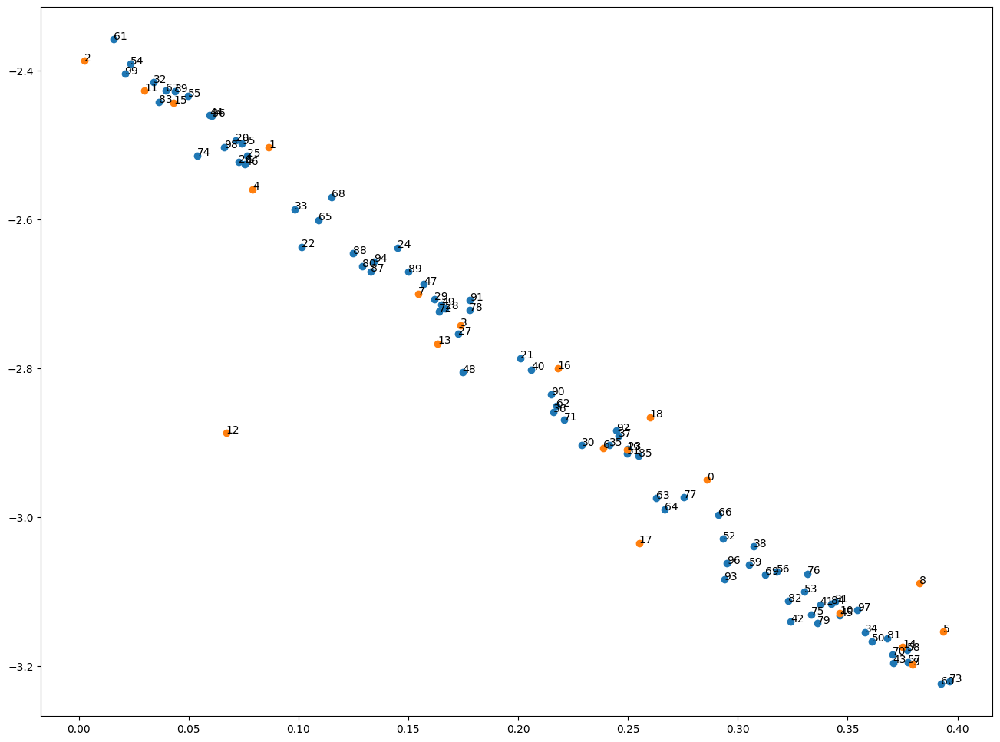

[0.2859264  0.0864358  0.0024921  0.17391661 0.07907403 0.39336027
 0.23893358 0.15462851 0.38266119 0.37959092]
[0.34651572 0.02997943 0.06718887 0.16337754 0.37502863 0.04327735
 0.21808106 0.2550441  0.25992204 0.24956645]
[0.07158956 0.20101322 0.10147186 0.24997234 0.14514144 0.07657856
 0.07297816 0.17272883 0.16671052 0.16193009]
[0.22885551 0.34440572 0.03386464 0.09818148 0.35786052 0.2414254
 0.21602989 0.24582514 0.30710321 0.04392725]
[0.20586148 0.3374828  0.32405777 0.37068828 0.05949074 0.34630997
 0.0756103  0.15711247 0.17470652 0.16498888]
[0.36096874 0.24942754 0.29319949 0.33040915 0.02355204 0.04960585
 0.31776933 0.377519   0.37703434 0.30519746]
[0.39248397 0.01603645 0.21731613 0.26299385 0.26662336 0.10898858
 0.29130778 0.03973111 0.11521473 0.31261245]
[0.37032344 0.22077058 0.16383656 0.39631873 0.05390104 0.33351255
 0.33176718 0.27528851 0.17781627 0.33618643]
[0.12902999 0.36799494 0.32301958 0.03636422 0.34247351 0.25473947
 0.06075424 0.13299807 0.12488

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-06-12 07:21:20.091540


# Iter2

In [21]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 0.95023  validloss 2.95100±0.00000  bestvalidloss 2.95100  last_update 0
train: iter 1  trainloss 0.52948  validloss 0.49790±0.00000  bestvalidloss 0.49790  last_update 0
train: iter 2  trainloss 0.48579  validloss 0.44721±0.00000  bestvalidloss 0.44721  last_update 0
train: iter 3  trainloss 0.46648  validloss 0.41476±0.00000  bestvalidloss 0.41476  last_update 0
train: iter 4  trainloss 0.45099  validloss 0.39295±0.00000  bestvalidloss 0.39295  last_update 0
train: iter 5  trainloss 0.43973  validloss 0.37947±0.00000  bestvalidloss 0.37947  last_update 0
train: iter 6  trainloss 0.43242  validloss 0.37211±0.00000  bestvalidloss 0.37211  last_update 0
train: iter 7  trainloss 0.42269  validloss 0.36404±0.00000  bestvalidloss 0.36404  last_update 0
train: iter 8  trainloss 0.41371  validloss 0.36121±0.00000  bestvalidloss 0.36121  last_update 0
train: iter 9  trainloss 0.40724  validloss 0.35451±0.00000  bestvalidloss 0.35451  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.34615  validloss 0.31801±0.00000  bestvalidloss 0.31000  last_update 6
train: iter 84  trainloss 0.34420  validloss 0.31051±0.00000  bestvalidloss 0.31000  last_update 7
train: iter 85  trainloss 0.34499  validloss 0.31090±0.00000  bestvalidloss 0.31000  last_update 8
train: iter 86  trainloss 0.34795  validloss 0.31446±0.00000  bestvalidloss 0.31000  last_update 9
train: iter 87  trainloss 0.34438  validloss 0.31025±0.00000  bestvalidloss 0.31000  last_update 10
train: iter 88  trainloss 0.34265  validloss 0.31701±0.00000  bestvalidloss 0.31000  last_update 11
train: iter 89  trainloss 0.34500  validloss 0.30887±0.00000  bestvalidloss 0.30887  last_update 0
train: iter 90  trainloss 0.34670  validloss 0.31559±0.00000  bestvalidloss 0.30887  last_update 1
train: iter 91  trainloss 0.34355  validloss 0.31124±0.00000  bestvalidloss 0.30887  last_update 2
train: iter 92  trainloss 0.34491  validloss 0.30998±0.00000  bestvalidloss 0.30887  last_update 3
train: i

train: iter 166  trainloss 0.32994  validloss 0.30023±0.00000  bestvalidloss 0.29870  last_update 5
train: iter 167  trainloss 0.33121  validloss 0.30508±0.00000  bestvalidloss 0.29870  last_update 6
train: iter 168  trainloss 0.32930  validloss 0.30142±0.00000  bestvalidloss 0.29870  last_update 7
train: iter 169  trainloss 0.33079  validloss 0.30055±0.00000  bestvalidloss 0.29870  last_update 8
train: iter 170  trainloss 0.32981  validloss 0.30269±0.00000  bestvalidloss 0.29870  last_update 9
train: iter 171  trainloss 0.32942  validloss 0.30316±0.00000  bestvalidloss 0.29870  last_update 10
train: iter 172  trainloss 0.33080  validloss 0.30096±0.00000  bestvalidloss 0.29870  last_update 11
train: iter 173  trainloss 0.32659  validloss 0.30288±0.00000  bestvalidloss 0.29870  last_update 12
train: iter 174  trainloss 0.33080  validloss 0.29764±0.00000  bestvalidloss 0.29764  last_update 0
train: iter 175  trainloss 0.32834  validloss 0.30019±0.00000  bestvalidloss 0.29764  last_update

train: iter 248  trainloss 0.31928  validloss 0.29400±0.00000  bestvalidloss 0.29225  last_update 3
train: iter 249  trainloss 0.32113  validloss 0.29359±0.00000  bestvalidloss 0.29225  last_update 4
train: iter 250  trainloss 0.31994  validloss 0.29318±0.00000  bestvalidloss 0.29225  last_update 5
train: iter 251  trainloss 0.32037  validloss 0.29693±0.00000  bestvalidloss 0.29225  last_update 6
train: iter 252  trainloss 0.31964  validloss 0.29224±0.00000  bestvalidloss 0.29224  last_update 0
train: iter 253  trainloss 0.31894  validloss 0.29219±0.00000  bestvalidloss 0.29219  last_update 0
train: iter 254  trainloss 0.31932  validloss 0.29683±0.00000  bestvalidloss 0.29219  last_update 1
train: iter 255  trainloss 0.31783  validloss 0.29413±0.00000  bestvalidloss 0.29219  last_update 2
train: iter 256  trainloss 0.32114  validloss 0.29291±0.00000  bestvalidloss 0.29219  last_update 3
train: iter 257  trainloss 0.31817  validloss 0.29357±0.00000  bestvalidloss 0.29219  last_update 4


train: iter 330  trainloss 0.31360  validloss 0.28872±0.00000  bestvalidloss 0.28757  last_update 2
train: iter 331  trainloss 0.31511  validloss 0.29177±0.00000  bestvalidloss 0.28757  last_update 3
train: iter 332  trainloss 0.31407  validloss 0.29420±0.00000  bestvalidloss 0.28757  last_update 4
train: iter 333  trainloss 0.31175  validloss 0.29229±0.00000  bestvalidloss 0.28757  last_update 5
train: iter 334  trainloss 0.31211  validloss 0.29498±0.00000  bestvalidloss 0.28757  last_update 6
train: iter 335  trainloss 0.31276  validloss 0.30056±0.00000  bestvalidloss 0.28757  last_update 7
train: iter 336  trainloss 0.31098  validloss 0.28862±0.00000  bestvalidloss 0.28757  last_update 8
train: iter 337  trainloss 0.31255  validloss 0.29341±0.00000  bestvalidloss 0.28757  last_update 9
train: iter 338  trainloss 0.31351  validloss 0.28933±0.00000  bestvalidloss 0.28757  last_update 10
train: iter 339  trainloss 0.31100  validloss 0.28983±0.00000  bestvalidloss 0.28757  last_update 1

train: iter 412  trainloss 0.30963  validloss 0.29057±0.00000  bestvalidloss 0.28438  last_update 16
train: iter 413  trainloss 0.31173  validloss 0.28635±0.00000  bestvalidloss 0.28438  last_update 17
train: iter 414  trainloss 0.31059  validloss 0.28536±0.00000  bestvalidloss 0.28438  last_update 18
train: iter 415  trainloss 0.30857  validloss 0.29247±0.00000  bestvalidloss 0.28438  last_update 19
train: iter 416  trainloss 0.30808  validloss 0.29241±0.00000  bestvalidloss 0.28438  last_update 20
train: iter 417  trainloss 0.30795  validloss 0.29027±0.00000  bestvalidloss 0.28438  last_update 21
train: iter 418  trainloss 0.30883  validloss 0.28520±0.00000  bestvalidloss 0.28438  last_update 22
train: iter 419  trainloss 0.30941  validloss 0.28708±0.00000  bestvalidloss 0.28438  last_update 23
train: iter 420  trainloss 0.30820  validloss 0.28833±0.00000  bestvalidloss 0.28438  last_update 24
train: iter 421  trainloss 0.30995  validloss 0.28716±0.00000  bestvalidloss 0.28438  last_

train: iter 494  trainloss 0.30565  validloss 0.28397±0.00000  bestvalidloss 0.28272  last_update 17
train: iter 495  trainloss 0.30736  validloss 0.29173±0.00000  bestvalidloss 0.28272  last_update 18
train: iter 496  trainloss 0.30593  validloss 0.28887±0.00000  bestvalidloss 0.28272  last_update 19
train: iter 497  trainloss 0.30693  validloss 0.28776±0.00000  bestvalidloss 0.28272  last_update 20
train: iter 498  trainloss 0.30622  validloss 0.29062±0.00000  bestvalidloss 0.28272  last_update 21
train: iter 499  trainloss 0.30988  validloss 0.28349±0.00000  bestvalidloss 0.28272  last_update 22
train: iter 500  trainloss 0.30655  validloss 0.28622±0.00000  bestvalidloss 0.28272  last_update 23
train: iter 501  trainloss 0.30737  validloss 0.29303±0.00000  bestvalidloss 0.28272  last_update 24
train: iter 502  trainloss 0.30474  validloss 0.28395±0.00000  bestvalidloss 0.28272  last_update 25
train: iter 503  trainloss 0.30716  validloss 0.28688±0.00000  bestvalidloss 0.28272  last_

train: iter 576  trainloss 0.30451  validloss 0.28416±0.00000  bestvalidloss 0.28029  last_update 12
train: iter 577  trainloss 0.30285  validloss 0.28689±0.00000  bestvalidloss 0.28029  last_update 13
train: iter 578  trainloss 0.30326  validloss 0.28096±0.00000  bestvalidloss 0.28029  last_update 14
train: iter 579  trainloss 0.30765  validloss 0.28234±0.00000  bestvalidloss 0.28029  last_update 15
train: iter 580  trainloss 0.30325  validloss 0.28074±0.00000  bestvalidloss 0.28029  last_update 16
train: iter 581  trainloss 0.30378  validloss 0.28274±0.00000  bestvalidloss 0.28029  last_update 17
train: iter 582  trainloss 0.30444  validloss 0.28198±0.00000  bestvalidloss 0.28029  last_update 18
train: iter 583  trainloss 0.30408  validloss 0.28258±0.00000  bestvalidloss 0.28029  last_update 19
train: iter 584  trainloss 0.30251  validloss 0.28277±0.00000  bestvalidloss 0.28029  last_update 20
train: iter 585  trainloss 0.30616  validloss 0.28251±0.00000  bestvalidloss 0.28029  last_

train: iter 658  trainloss 0.30153  validloss 0.28922±0.00000  bestvalidloss 0.27933  last_update 8
train: iter 659  trainloss 0.30208  validloss 0.28327±0.00000  bestvalidloss 0.27933  last_update 9
train: iter 660  trainloss 0.30242  validloss 0.28603±0.00000  bestvalidloss 0.27933  last_update 10
train: iter 661  trainloss 0.30337  validloss 0.28305±0.00000  bestvalidloss 0.27933  last_update 11
train: iter 662  trainloss 0.30122  validloss 0.28326±0.00000  bestvalidloss 0.27933  last_update 12
train: iter 663  trainloss 0.30140  validloss 0.28231±0.00000  bestvalidloss 0.27933  last_update 13
train: iter 664  trainloss 0.30250  validloss 0.28206±0.00000  bestvalidloss 0.27933  last_update 14
train: iter 665  trainloss 0.30203  validloss 0.28567±0.00000  bestvalidloss 0.27933  last_update 15
train: iter 666  trainloss 0.30059  validloss 0.28575±0.00000  bestvalidloss 0.27933  last_update 16
train: iter 667  trainloss 0.30238  validloss 0.29177±0.00000  bestvalidloss 0.27933  last_up

train: iter 740  trainloss 0.30106  validloss 0.28549±0.00000  bestvalidloss 0.27759  last_update 25
train: iter 741  trainloss 0.30016  validloss 0.28336±0.00000  bestvalidloss 0.27759  last_update 26
train: iter 742  trainloss 0.29993  validloss 0.28291±0.00000  bestvalidloss 0.27759  last_update 27
train: iter 743  trainloss 0.30018  validloss 0.28500±0.00000  bestvalidloss 0.27759  last_update 28
train: iter 744  trainloss 0.30058  validloss 0.28395±0.00000  bestvalidloss 0.27759  last_update 29
train: iter 745  trainloss 0.29891  validloss 0.28077±0.00000  bestvalidloss 0.27759  last_update 30
train: iter 746  trainloss 0.29872  validloss 0.28503±0.00000  bestvalidloss 0.27759  last_update 31
train: iter 747  trainloss 0.30041  validloss 0.27991±0.00000  bestvalidloss 0.27759  last_update 32
train: iter 748  trainloss 0.29926  validloss 0.28038±0.00000  bestvalidloss 0.27759  last_update 33
train: iter 749  trainloss 0.29896  validloss 0.28409±0.00000  bestvalidloss 0.27759  last_

train: iter 822  trainloss 0.29735  validloss 0.28214±0.00000  bestvalidloss 0.27693  last_update 13
train: iter 823  trainloss 0.29851  validloss 0.27907±0.00000  bestvalidloss 0.27693  last_update 14
train: iter 824  trainloss 0.29869  validloss 0.28793±0.00000  bestvalidloss 0.27693  last_update 15
train: iter 825  trainloss 0.29693  validloss 0.28494±0.00000  bestvalidloss 0.27693  last_update 16
train: iter 826  trainloss 0.30045  validloss 0.28772±0.00000  bestvalidloss 0.27693  last_update 17
train: iter 827  trainloss 0.29763  validloss 0.28677±0.00000  bestvalidloss 0.27693  last_update 18
train: iter 828  trainloss 0.29871  validloss 0.28347±0.00000  bestvalidloss 0.27693  last_update 19
train: iter 829  trainloss 0.29782  validloss 0.28852±0.00000  bestvalidloss 0.27693  last_update 20
train: iter 830  trainloss 0.29849  validloss 0.28863±0.00000  bestvalidloss 0.27693  last_update 21
train: iter 831  trainloss 0.29789  validloss 0.27964±0.00000  bestvalidloss 0.27693  last_

train: iter 904  trainloss 0.29586  validloss 0.28143±0.00000  bestvalidloss 0.27693  last_update 95
train: iter 905  trainloss 0.29583  validloss 0.27838±0.00000  bestvalidloss 0.27693  last_update 96
train: iter 906  trainloss 0.29740  validloss 0.28137±0.00000  bestvalidloss 0.27693  last_update 97
train: iter 907  trainloss 0.29600  validloss 0.28216±0.00000  bestvalidloss 0.27693  last_update 98
train: iter 908  trainloss 0.29599  validloss 0.28416±0.00000  bestvalidloss 0.27693  last_update 99
train: iter 909  trainloss 0.29648  validloss 0.28453±0.00000  bestvalidloss 0.27693  last_update 100
train: fin


([0.9502314906567335,
  0.5294792611151934,
  0.4857889637351036,
  0.4664807222783566,
  0.4509931329637766,
  0.4397318307310343,
  0.432423123344779,
  0.4226910412311554,
  0.4137088354676962,
  0.4072442941367626,
  0.4030606146901846,
  0.39731742162257433,
  0.39118537940084935,
  0.38896814584732053,
  0.38444314431399107,
  0.3816073076799512,
  0.3791933098807931,
  0.37626293729990723,
  0.3759442107751966,
  0.37301159594208,
  0.37093147821724415,
  0.3720262721180916,
  0.37083173394203184,
  0.36919884365051986,
  0.3696542773395777,
  0.36880513057112696,
  0.3669913923367858,
  0.3659087335690856,
  0.3671938916668296,
  0.3644230652600527,
  0.3635115597397089,
  0.3620628068223596,
  0.3642407201230526,
  0.3628337310627103,
  0.36107486188411714,
  0.36040913239121436,
  0.36138370633125305,
  0.3600596275180578,
  0.3596161354333162,
  0.35901502799242735,
  0.3578971052542329,
  0.35860534440726044,
  0.3599805697798729,
  0.35698178932070734,
  0.3565862329676747

In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -1.39276515006423
valid_loss:  -1.1224469068884848
weight_alpha 1.0 h_min_tilde -6.1621194 ell_tilde -1.338701501429081 kappa_tilde 0.00045532611022275235
train_loss:  -3.4685464820861815
valid_loss:  -3.0093872577667238
weight_alpha 0.1 h_min_tilde -6.1621194 ell_tilde -3.3767146372222903 kappa_tilde 0.0005991779792398092


1e-08 1000.0


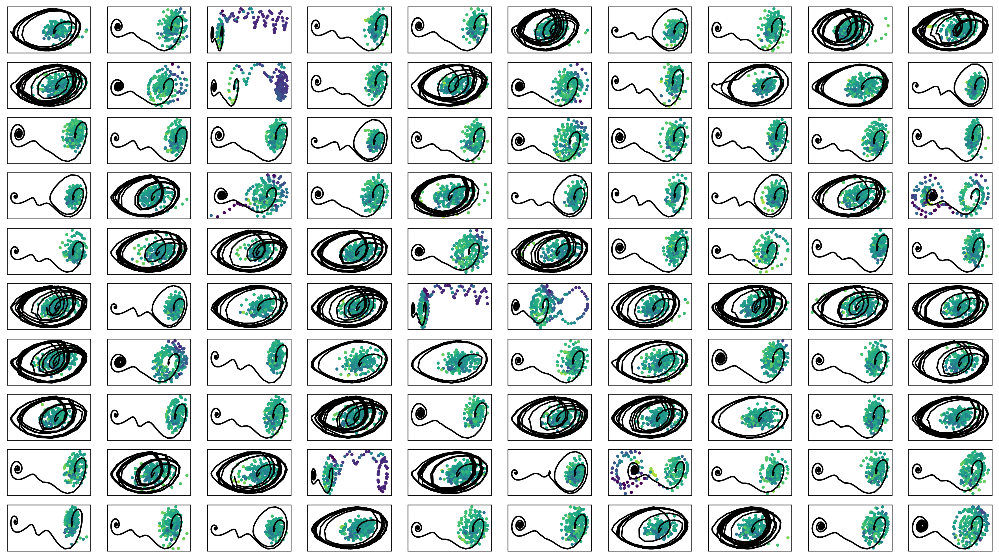

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [25]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()

train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -679.12115  validloss -601.76689±0.00000  bestvalidloss -601.76689  last_update 0
train: iter 1  trainloss -684.24394  validloss -597.06074±0.00000  bestvalidloss -601.76689  last_update 1
train: iter 2  trainloss -690.84186  validloss -615.61658±0.00000  bestvalidloss -615.61658  last_update 0
train: iter 3  trainloss -683.66590  validloss -628.05146±0.00000  bestvalidloss -628.05146  last_update 0
train: iter 4  trainloss -685.34880  validloss -632.06533±0.00000  bestvalidloss -632.06533  last_update 0
train: iter 5  trainloss -674.40791  validloss -563.42049±0.00000  bestvalidloss -632.06533  last_update 1
train: iter 6  trainloss -684.34146  validloss -567.68232±0.00000  bestvalidloss -632.06533  last_update 2
train: iter 7  trainloss -670.48250  validloss -555.52751±0.00000  bestvalidloss -632.06533  last_update 3
train: iter 8  trainloss -672.21776  validloss -623.43606±0.00000  bestvalidloss -632.06533  last_u

train: iter 76  trainloss -687.34020  validloss -628.79103±0.00000  bestvalidloss -649.59578  last_update 12
train: iter 77  trainloss -680.89011  validloss -637.33504±0.00000  bestvalidloss -649.59578  last_update 13
train: iter 78  trainloss -672.54676  validloss -524.31841±0.00000  bestvalidloss -649.59578  last_update 14
train: iter 79  trainloss -693.07587  validloss -635.32622±0.00000  bestvalidloss -649.59578  last_update 15
train: iter 80  trainloss -685.31700  validloss -571.38660±0.00000  bestvalidloss -649.59578  last_update 16
train: iter 81  trainloss -691.04398  validloss -636.77673±0.00000  bestvalidloss -649.59578  last_update 17
train: iter 82  trainloss -685.90763  validloss -640.21836±0.00000  bestvalidloss -649.59578  last_update 18
train: iter 83  trainloss -675.57059  validloss -609.49330±0.00000  bestvalidloss -649.59578  last_update 19
train: iter 84  trainloss -691.23452  validloss -638.21888±0.00000  bestvalidloss -649.59578  last_update 20
train: iter 85  tra

train: iter 151  trainloss -694.71673  validloss -657.38259±0.00000  bestvalidloss -657.38259  last_update 0
train: iter 152  trainloss -675.59145  validloss -575.24934±0.00000  bestvalidloss -657.38259  last_update 1
train: iter 153  trainloss -698.59959  validloss -587.55826±0.00000  bestvalidloss -657.38259  last_update 2
train: iter 154  trainloss -683.70730  validloss -640.02571±0.00000  bestvalidloss -657.38259  last_update 3
train: iter 155  trainloss -705.80442  validloss -638.40597±0.00000  bestvalidloss -657.38259  last_update 4
train: iter 156  trainloss -692.69471  validloss -626.70980±0.00000  bestvalidloss -657.38259  last_update 5
train: iter 157  trainloss -672.65197  validloss -628.46269±0.00000  bestvalidloss -657.38259  last_update 6
train: iter 158  trainloss -694.97180  validloss -606.13861±0.00000  bestvalidloss -657.38259  last_update 7
train: iter 159  trainloss -699.85406  validloss -625.17667±0.00000  bestvalidloss -657.38259  last_update 8
train: iter 160  tr

train: iter 226  trainloss -714.96902  validloss -625.32461±0.00000  bestvalidloss -662.66138  last_update 24
train: iter 227  trainloss -689.12077  validloss -635.53660±0.00000  bestvalidloss -662.66138  last_update 25
train: iter 228  trainloss -702.09679  validloss -626.59583±0.00000  bestvalidloss -662.66138  last_update 26
train: iter 229  trainloss -709.35458  validloss -604.78514±0.00000  bestvalidloss -662.66138  last_update 27
train: iter 230  trainloss -692.80007  validloss -633.28653±0.00000  bestvalidloss -662.66138  last_update 28
train: iter 231  trainloss -709.17389  validloss -644.37305±0.00000  bestvalidloss -662.66138  last_update 29
train: iter 232  trainloss -691.60070  validloss -542.49624±0.00000  bestvalidloss -662.66138  last_update 30
train: iter 233  trainloss -706.42343  validloss -615.70687±0.00000  bestvalidloss -662.66138  last_update 31
train: iter 234  trainloss -695.79112  validloss -637.04640±0.00000  bestvalidloss -662.66138  last_update 32
train: ite

train: iter 301  trainloss -713.10060  validloss -653.91861±0.00000  bestvalidloss -670.37928  last_update 3
train: iter 302  trainloss -673.59849  validloss -654.62805±0.00000  bestvalidloss -670.37928  last_update 4
train: iter 303  trainloss -711.66120  validloss -622.94838±0.00000  bestvalidloss -670.37928  last_update 5
train: iter 304  trainloss -713.81349  validloss -659.28727±0.00000  bestvalidloss -670.37928  last_update 6
train: iter 305  trainloss -723.94377  validloss -641.58938±0.00000  bestvalidloss -670.37928  last_update 7
train: iter 306  trainloss -713.18892  validloss -657.14464±0.00000  bestvalidloss -670.37928  last_update 8
train: iter 307  trainloss -717.03406  validloss -652.85798±0.00000  bestvalidloss -670.37928  last_update 9
train: iter 308  trainloss -708.41526  validloss -636.91885±0.00000  bestvalidloss -670.37928  last_update 10
train: iter 309  trainloss -701.65120  validloss -614.55905±0.00000  bestvalidloss -670.37928  last_update 11
train: iter 310  

train: iter 376  trainloss -717.15981  validloss -648.79251±0.00000  bestvalidloss -682.95369  last_update 37
train: iter 377  trainloss -714.30111  validloss -672.43283±0.00000  bestvalidloss -682.95369  last_update 38
train: iter 378  trainloss -707.46311  validloss -663.66351±0.00000  bestvalidloss -682.95369  last_update 39
train: iter 379  trainloss -722.57666  validloss -618.83481±0.00000  bestvalidloss -682.95369  last_update 40
train: iter 380  trainloss -723.13182  validloss -650.83768±0.00000  bestvalidloss -682.95369  last_update 41
train: iter 381  trainloss -730.76158  validloss -660.03301±0.00000  bestvalidloss -682.95369  last_update 42
train: iter 382  trainloss -716.82141  validloss -671.15760±0.00000  bestvalidloss -682.95369  last_update 43
train: iter 383  trainloss -730.28855  validloss -662.62363±0.00000  bestvalidloss -682.95369  last_update 44
train: iter 384  trainloss -707.57975  validloss -640.03143±0.00000  bestvalidloss -682.95369  last_update 45
train: ite

train: iter 451  trainloss -737.29507  validloss -692.74562±0.00000  bestvalidloss -696.31076  last_update 4
train: iter 452  trainloss -725.35502  validloss -659.25834±0.00000  bestvalidloss -696.31076  last_update 5
train: iter 453  trainloss -723.32685  validloss -695.12039±0.00000  bestvalidloss -696.31076  last_update 6
train: iter 454  trainloss -730.27096  validloss -674.66991±0.00000  bestvalidloss -696.31076  last_update 7
train: iter 455  trainloss -744.05585  validloss -679.02564±0.00000  bestvalidloss -696.31076  last_update 8
train: iter 456  trainloss -733.95525  validloss -680.75577±0.00000  bestvalidloss -696.31076  last_update 9
train: iter 457  trainloss -730.31105  validloss -685.41279±0.00000  bestvalidloss -696.31076  last_update 10
train: iter 458  trainloss -737.87995  validloss -697.95925±0.00000  bestvalidloss -697.95925  last_update 0
train: iter 459  trainloss -734.20520  validloss -660.99156±0.00000  bestvalidloss -697.95925  last_update 1
train: iter 460  t

train: iter 526  trainloss -743.63634  validloss -677.56473±0.00000  bestvalidloss -705.38361  last_update 35
train: iter 527  trainloss -736.13534  validloss -689.76135±0.00000  bestvalidloss -705.38361  last_update 36
train: iter 528  trainloss -749.66940  validloss -702.02677±0.00000  bestvalidloss -705.38361  last_update 37
train: iter 529  trainloss -752.30084  validloss -630.22859±0.00000  bestvalidloss -705.38361  last_update 38
train: iter 530  trainloss -752.43203  validloss -671.42512±0.00000  bestvalidloss -705.38361  last_update 39
train: iter 531  trainloss -750.49743  validloss -678.44400±0.00000  bestvalidloss -705.38361  last_update 40
train: iter 532  trainloss -735.86264  validloss -651.70438±0.00000  bestvalidloss -705.38361  last_update 41
train: iter 533  trainloss -745.68444  validloss -655.08028±0.00000  bestvalidloss -705.38361  last_update 42
train: iter 534  trainloss -743.90605  validloss -695.87662±0.00000  bestvalidloss -705.38361  last_update 43
train: ite

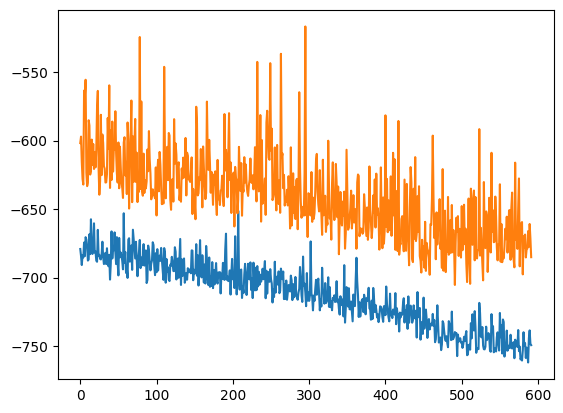

alpha 0.1 default_lr 0.0005


In [26]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

In [27]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)


実環境方策rollout vs Sim環境方策rollout


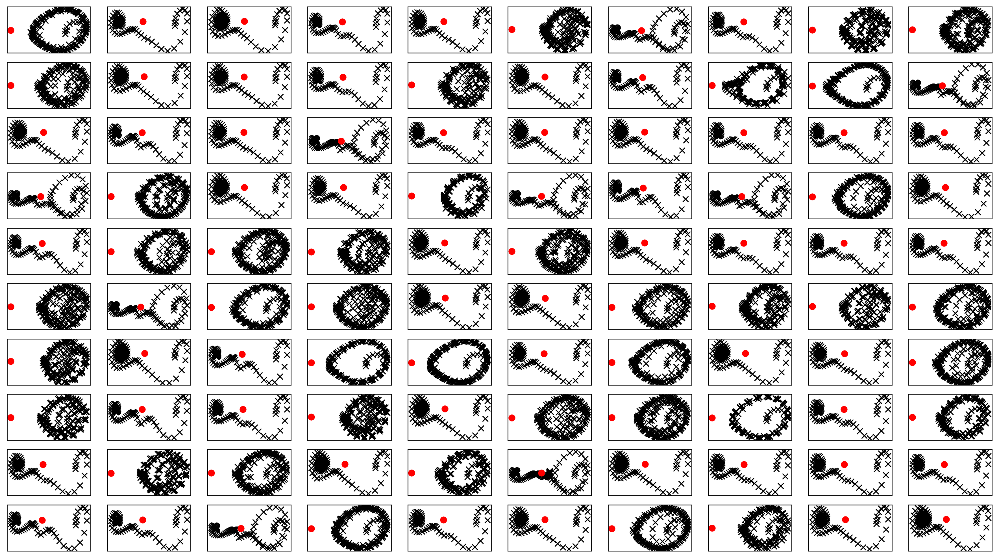

In [28]:

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro")     
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
# plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

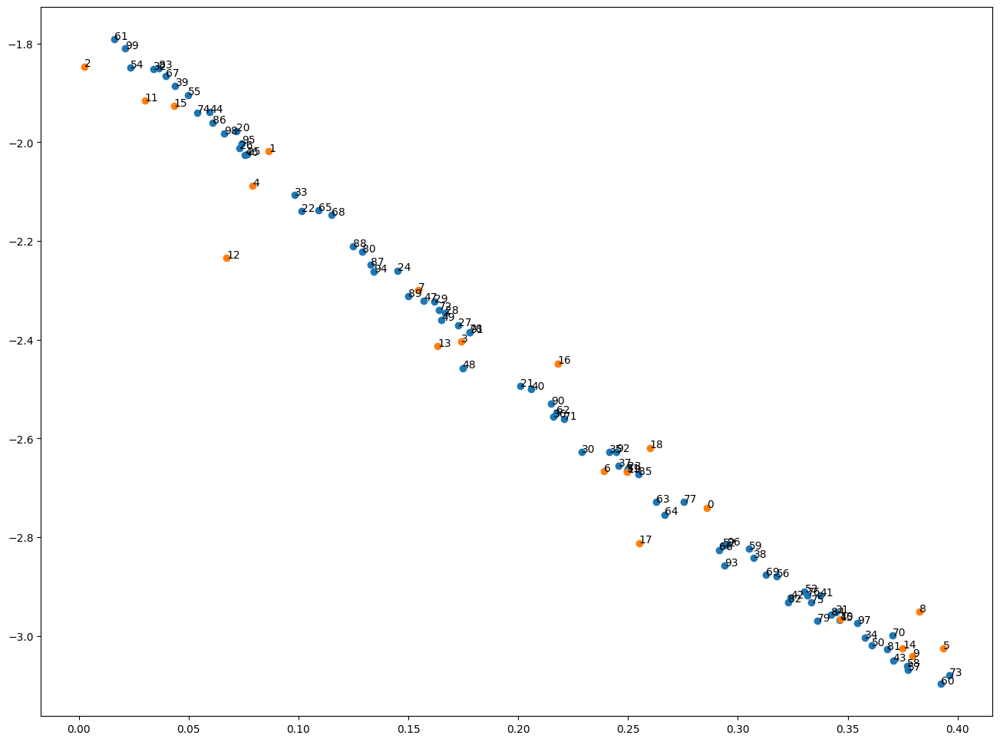

[0.2859264  0.0864358  0.0024921  0.17391661 0.07907403 0.39336027
 0.23893358 0.15462851 0.38266119 0.37959092]
[0.34651572 0.02997943 0.06718887 0.16337754 0.37502863 0.04327735
 0.21808106 0.2550441  0.25992204 0.24956645]
[0.07158956 0.20101322 0.10147186 0.24997234 0.14514144 0.07657856
 0.07297816 0.17272883 0.16671052 0.16193009]
[0.22885551 0.34440572 0.03386464 0.09818148 0.35786052 0.2414254
 0.21602989 0.24582514 0.30710321 0.04392725]
[0.20586148 0.3374828  0.32405777 0.37068828 0.05949074 0.34630997
 0.0756103  0.15711247 0.17470652 0.16498888]
[0.36096874 0.24942754 0.29319949 0.33040915 0.02355204 0.04960585
 0.31776933 0.377519   0.37703434 0.30519746]
[0.39248397 0.01603645 0.21731613 0.26299385 0.26662336 0.10898858
 0.29130778 0.03973111 0.11521473 0.31261245]
[0.37032344 0.22077058 0.16383656 0.39631873 0.05390104 0.33351255
 0.33176718 0.27528851 0.17781627 0.33618643]
[0.12902999 0.36799494 0.32301958 0.03636422 0.34247351 0.25473947
 0.06075424 0.13299807 0.12488

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-06-12 07:47:16.425343


Text(0, 0.5, 'loss')

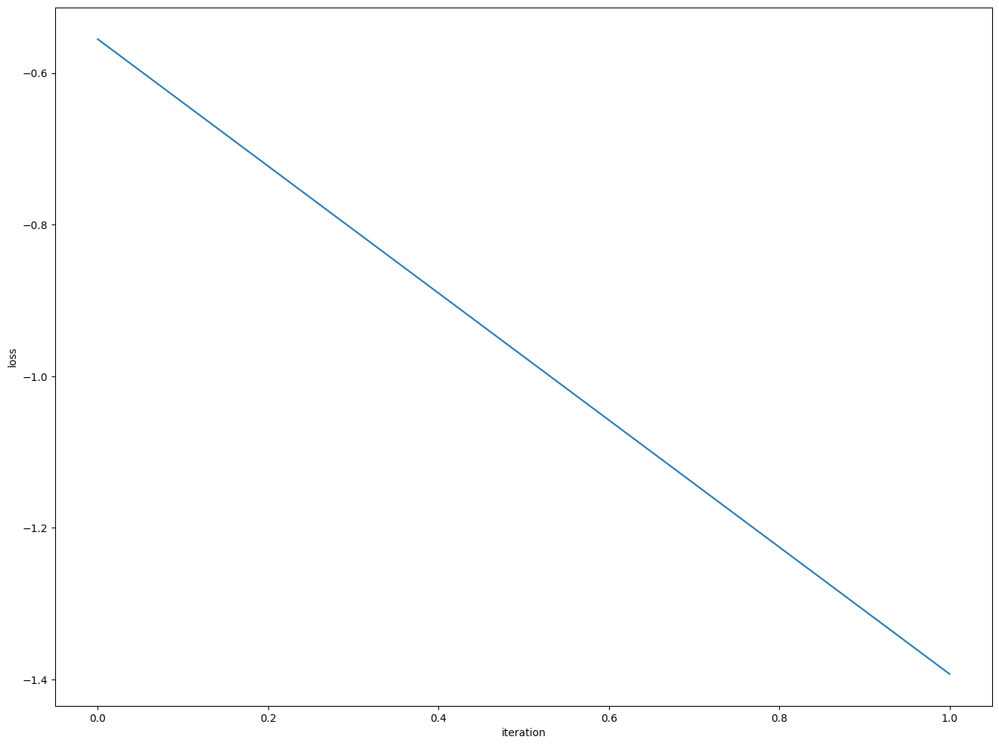

In [31]:
loss_array = np.array(loss_list)
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")


Text(0, 0.5, 'loss')

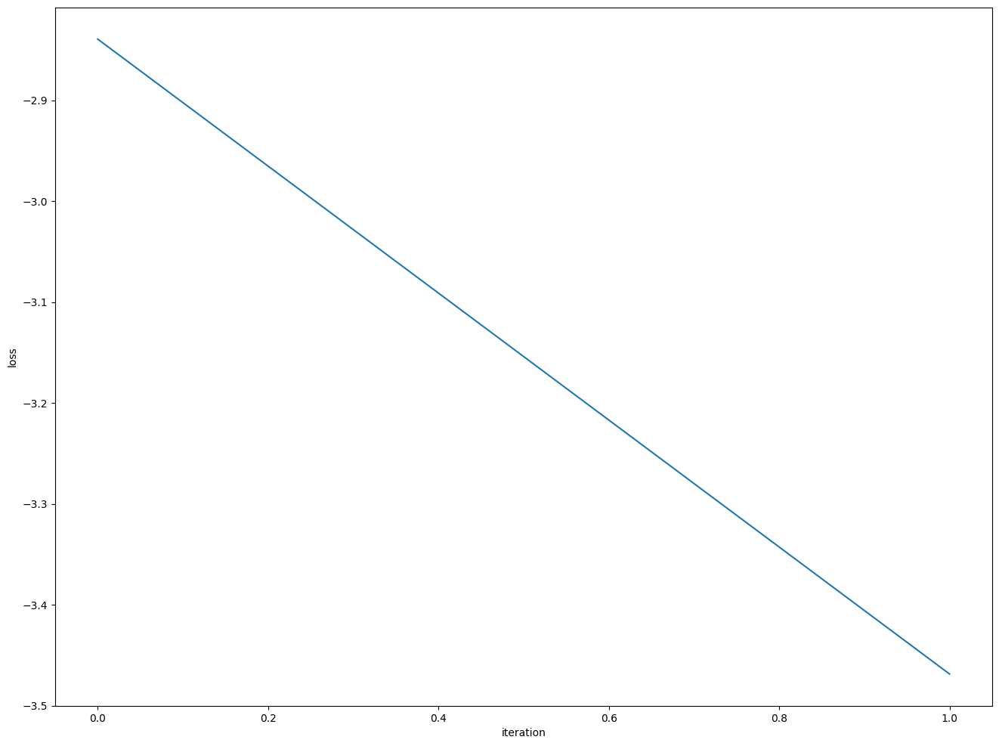

In [32]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")


# Iter 3

In [33]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5

 6

 7

 8

 9

 10
predict diverge [-1.64835892 27.80867509] [ 1.14242756 10.77287421] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 78

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31
predict diverge [ -5.50998023 -27.77865114] [ -1.48994195 -10.78040823] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 49

 32

 33

 34

 35

 36

 37

 38
predict diverge [-4.18128806 21.81617145] [ 0.9369537  11.10606427] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 48

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60
predict diverge [-3.38852888 25.95598864] [ 1.1602343  11.35417413] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 67

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 75

 76

 77
predict diverge [-1.11299502 23.74198981] [ 0.76858158 12.2985463 ] [91.57898 20.     ] [45.78949 10.     ] sim_timestep

In [34]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 0.50785  validloss 1.40708±0.00000  bestvalidloss 1.40708  last_update 0
train: iter 1  trainloss 0.34990  validloss 0.33725±0.00000  bestvalidloss 0.33725  last_update 0
train: iter 2  trainloss 0.33563  validloss 0.31315±0.00000  bestvalidloss 0.31315  last_update 0
train: iter 3  trainloss 0.32744  validloss 0.30291±0.00000  bestvalidloss 0.30291  last_update 0
train: iter 4  trainloss 0.32384  validloss 0.29315±0.00000  bestvalidloss 0.29315  last_update 0
train: iter 5  trainloss 0.31854  validloss 0.29454±0.00000  bestvalidloss 0.29315  last_update 1
train: iter 6  trainloss 0.31741  validloss 0.29186±0.00000  bestvalidloss 0.29186  last_update 0
train: iter 7  trainloss 0.31797  validloss 0.28604±0.00000  bestvalidloss 0.28604  last_update 0
train: iter 8  trainloss 0.31475  validloss 0.28701±0.00000  bestvalidloss 0.28604  last_update 1
train: iter 9  trainloss 0.31308  validloss 0.28623±0.00000  bestvalidloss 0.28604  last_update 2
train: iter 10  trai

train: iter 83  trainloss 0.30011  validloss 0.28158±0.00000  bestvalidloss 0.27624  last_update 18
train: iter 84  trainloss 0.30094  validloss 0.27953±0.00000  bestvalidloss 0.27624  last_update 19
train: iter 85  trainloss 0.29929  validloss 0.28261±0.00000  bestvalidloss 0.27624  last_update 20
train: iter 86  trainloss 0.30076  validloss 0.27514±0.00000  bestvalidloss 0.27514  last_update 0
train: iter 87  trainloss 0.30090  validloss 0.27675±0.00000  bestvalidloss 0.27514  last_update 1
train: iter 88  trainloss 0.30052  validloss 0.28335±0.00000  bestvalidloss 0.27514  last_update 2
train: iter 89  trainloss 0.30124  validloss 0.28804±0.00000  bestvalidloss 0.27514  last_update 3
train: iter 90  trainloss 0.30214  validloss 0.27732±0.00000  bestvalidloss 0.27514  last_update 4
train: iter 91  trainloss 0.30009  validloss 0.27910±0.00000  bestvalidloss 0.27514  last_update 5
train: iter 92  trainloss 0.29859  validloss 0.28281±0.00000  bestvalidloss 0.27514  last_update 6
train: 

train: iter 165  trainloss 0.29831  validloss 0.27767±0.00000  bestvalidloss 0.27514  last_update 79
train: iter 166  trainloss 0.29636  validloss 0.28206±0.00000  bestvalidloss 0.27514  last_update 80
train: iter 167  trainloss 0.29824  validloss 0.27809±0.00000  bestvalidloss 0.27514  last_update 81
train: iter 168  trainloss 0.29692  validloss 0.27850±0.00000  bestvalidloss 0.27514  last_update 82
train: iter 169  trainloss 0.29761  validloss 0.28007±0.00000  bestvalidloss 0.27514  last_update 83
train: iter 170  trainloss 0.29654  validloss 0.28202±0.00000  bestvalidloss 0.27514  last_update 84
train: iter 171  trainloss 0.30059  validloss 0.27830±0.00000  bestvalidloss 0.27514  last_update 85
train: iter 172  trainloss 0.29827  validloss 0.27949±0.00000  bestvalidloss 0.27514  last_update 86
train: iter 173  trainloss 0.29800  validloss 0.28669±0.00000  bestvalidloss 0.27514  last_update 87
train: iter 174  trainloss 0.29648  validloss 0.28129±0.00000  bestvalidloss 0.27514  last_

([0.5078473499044776,
  0.349902667850256,
  0.33563211336731913,
  0.32743882220238446,
  0.3238375959917903,
  0.31853909846395256,
  0.31740921549499035,
  0.3179734805598855,
  0.3147467140108347,
  0.31307766754180194,
  0.3113883137702942,
  0.3133301021531224,
  0.31013144049793484,
  0.31177533976733685,
  0.3117941909469664,
  0.3089727074839175,
  0.31080479910597203,
  0.3076878136023879,
  0.30746187437325717,
  0.30855400264263155,
  0.30772741641849277,
  0.3069467093795538,
  0.3071168322116137,
  0.30753614455461503,
  0.3070690088905394,
  0.3075583496131003,
  0.3057997325435281,
  0.30625559743493797,
  0.3058312859386206,
  0.30667980052530763,
  0.3053482203744352,
  0.303688642103225,
  0.3057056206278503,
  0.3055443987250328,
  0.305255681835115,
  0.30490945335477593,
  0.3068473806604743,
  0.30506045250222086,
  0.3041460379958153,
  0.30415404941886665,
  0.30476566683501005,
  0.30568099617958067,
  0.303299742937088,
  0.3040380790829659,
  0.3019491065293

In [35]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -1.8837601490020752
valid_loss:  -1.7387214892148972
weight_alpha 1.0 h_min_tilde -6.162122 ell_tilde -1.8547524170446397 kappa_tilde 0.0004818301178095037
train_loss:  -3.7178740638732903
valid_loss:  -3.3048781770706177
weight_alpha 0.1 h_min_tilde -6.162122 ell_tilde -3.6352748865127555 kappa_tilde 0.0006290867479456938


1e-08 1000.0


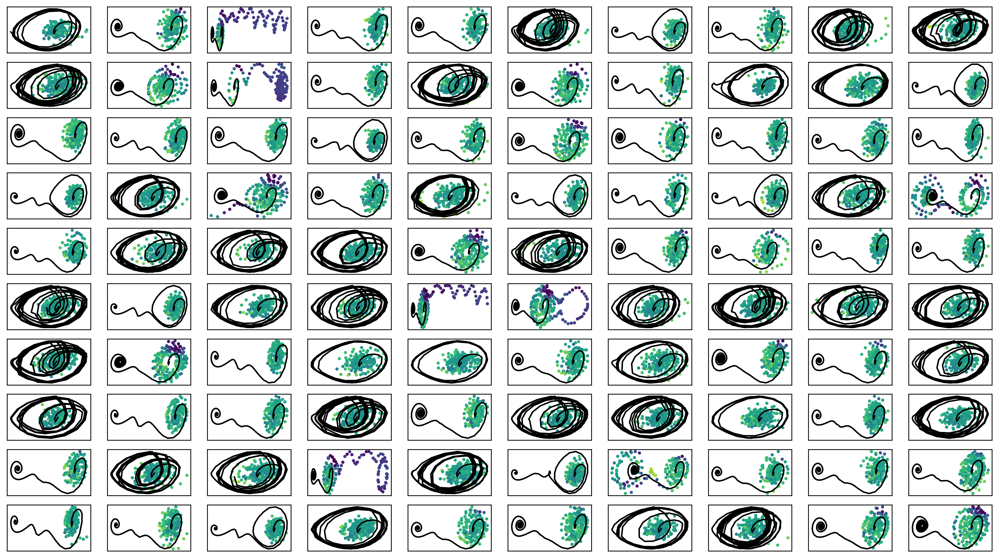

In [36]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [37]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -738.53158  validloss -652.21859±0.00000  bestvalidloss -652.21859  last_update 0
train: iter 1  trainloss -745.54212  validloss -667.05846±0.00000  bestvalidloss -667.05846  last_update 0
train: iter 2  trainloss -751.10684  validloss -657.79672±0.00000  bestvalidloss -667.05846  last_update 1
train: iter 3  trainloss -753.39456  validloss -675.00457±0.00000  bestvalidloss -675.00457  last_update 0
train: iter 4  trainloss -746.46703  validloss -624.21828±0.00000  bestvalidloss -675.00457  last_update 1
train: iter 5  trainloss -754.72506  validloss -665.80472±0.00000  bestvalidloss -675.00457  last_update 2
train: iter 6  trainloss -769.71735  validloss -640.36904±0.00000  bestvalidloss -675.00457  last_update 3
train: iter 7  trainloss -742.08384  validloss -604.17232±0.00000  bestvalidloss -675.00457  last_update 4
train: iter 8  trainloss -753.53234  validloss -699.24597±0.00000  bestvalidloss -699.24597  last_u

train: iter 76  trainloss -764.08130  validloss -685.94997±0.00000  bestvalidloss -706.19160  last_update 12
train: iter 77  trainloss -763.22773  validloss -699.73858±0.00000  bestvalidloss -706.19160  last_update 13
train: iter 78  trainloss -766.75614  validloss -667.40843±0.00000  bestvalidloss -706.19160  last_update 14
train: iter 79  trainloss -750.76013  validloss -649.55461±0.00000  bestvalidloss -706.19160  last_update 15
train: iter 80  trainloss -763.97024  validloss -653.04738±0.00000  bestvalidloss -706.19160  last_update 16
train: iter 81  trainloss -764.20846  validloss -685.49414±0.00000  bestvalidloss -706.19160  last_update 17
train: iter 82  trainloss -767.99387  validloss -656.12637±0.00000  bestvalidloss -706.19160  last_update 18
train: iter 83  trainloss -759.81189  validloss -626.76473±0.00000  bestvalidloss -706.19160  last_update 19
train: iter 84  trainloss -759.15196  validloss -650.93761±0.00000  bestvalidloss -706.19160  last_update 20
train: iter 85  tra

train: iter 151  trainloss -770.05811  validloss -676.83943±0.00000  bestvalidloss -706.19160  last_update 87
train: iter 152  trainloss -763.20718  validloss -695.66432±0.00000  bestvalidloss -706.19160  last_update 88
train: iter 153  trainloss -773.73468  validloss -689.35591±0.00000  bestvalidloss -706.19160  last_update 89
train: iter 154  trainloss -763.19856  validloss -675.89715±0.00000  bestvalidloss -706.19160  last_update 90
train: iter 155  trainloss -772.00364  validloss -684.33362±0.00000  bestvalidloss -706.19160  last_update 91
train: iter 156  trainloss -762.16837  validloss -651.49187±0.00000  bestvalidloss -706.19160  last_update 92
train: iter 157  trainloss -774.17324  validloss -712.72070±0.00000  bestvalidloss -712.72070  last_update 0
train: iter 158  trainloss -760.81656  validloss -676.00651±0.00000  bestvalidloss -712.72070  last_update 1
train: iter 159  trainloss -766.43829  validloss -673.59937±0.00000  bestvalidloss -712.72070  last_update 2
train: iter 1

train: iter 226  trainloss -776.20841  validloss -689.52172±0.00000  bestvalidloss -712.72070  last_update 69
train: iter 227  trainloss -780.45609  validloss -682.59218±0.00000  bestvalidloss -712.72070  last_update 70
train: iter 228  trainloss -766.89860  validloss -665.99941±0.00000  bestvalidloss -712.72070  last_update 71
train: iter 229  trainloss -781.64038  validloss -636.12635±0.00000  bestvalidloss -712.72070  last_update 72
train: iter 230  trainloss -773.83781  validloss -679.12951±0.00000  bestvalidloss -712.72070  last_update 73
train: iter 231  trainloss -772.80070  validloss -680.07673±0.00000  bestvalidloss -712.72070  last_update 74
train: iter 232  trainloss -774.89462  validloss -660.63942±0.00000  bestvalidloss -712.72070  last_update 75
train: iter 233  trainloss -778.83221  validloss -655.96917±0.00000  bestvalidloss -712.72070  last_update 76
train: iter 234  trainloss -764.74282  validloss -704.48070±0.00000  bestvalidloss -712.72070  last_update 77
train: ite

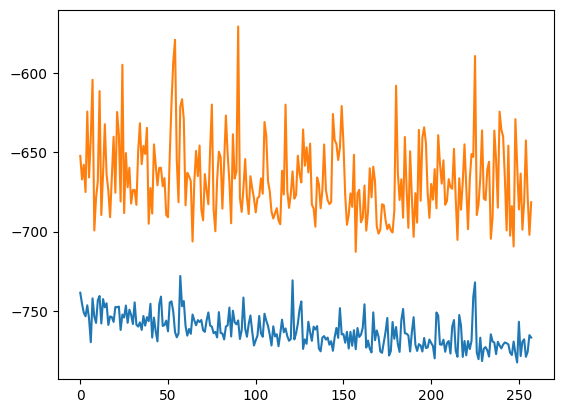

alpha 0.1 default_lr 0.0005


In [38]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

In [39]:
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)



実環境方策rollout vs Sim環境方策rollout


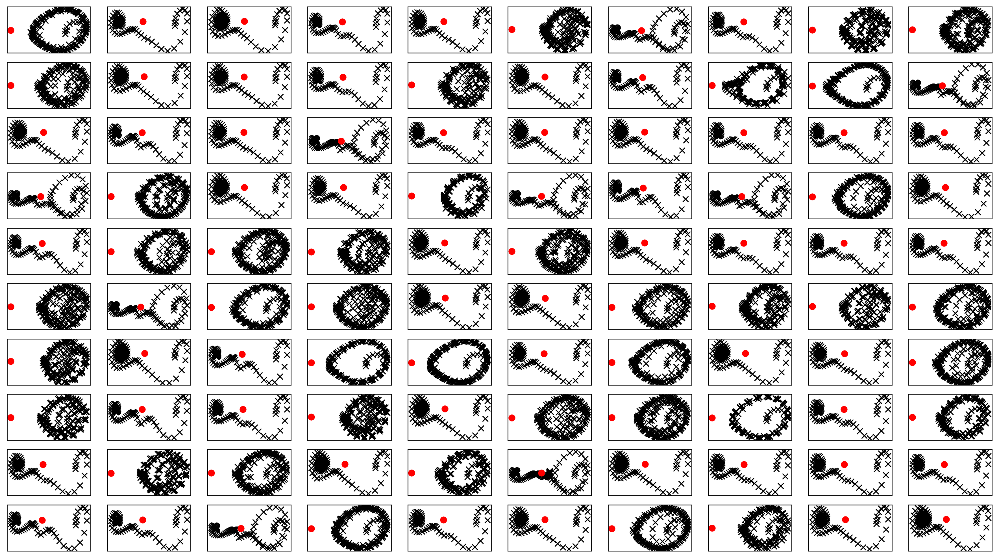

In [40]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
# plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

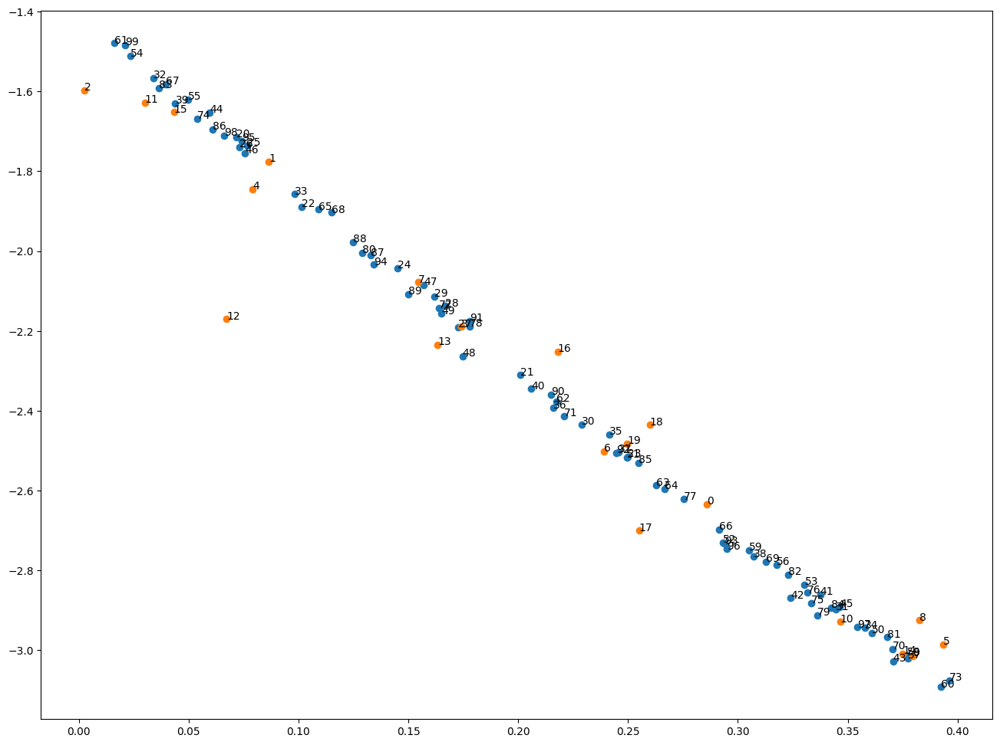

[0.2859264  0.0864358  0.0024921  0.17391661 0.07907403 0.39336027
 0.23893358 0.15462851 0.38266119 0.37959092]
[0.34651572 0.02997943 0.06718887 0.16337754 0.37502863 0.04327735
 0.21808106 0.2550441  0.25992204 0.24956645]
[0.07158956 0.20101322 0.10147186 0.24997234 0.14514144 0.07657856
 0.07297816 0.17272883 0.16671052 0.16193009]
[0.22885551 0.34440572 0.03386464 0.09818148 0.35786052 0.2414254
 0.21602989 0.24582514 0.30710321 0.04392725]
[0.20586148 0.3374828  0.32405777 0.37068828 0.05949074 0.34630997
 0.0756103  0.15711247 0.17470652 0.16498888]
[0.36096874 0.24942754 0.29319949 0.33040915 0.02355204 0.04960585
 0.31776933 0.377519   0.37703434 0.30519746]
[0.39248397 0.01603645 0.21731613 0.26299385 0.26662336 0.10898858
 0.29130778 0.03973111 0.11521473 0.31261245]
[0.37032344 0.22077058 0.16383656 0.39631873 0.05390104 0.33351255
 0.33176718 0.27528851 0.17781627 0.33618643]
[0.12902999 0.36799494 0.32301958 0.03636422 0.34247351 0.25473947
 0.06075424 0.13299807 0.12488

In [41]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [42]:
print(datetime.datetime.now())

2023-06-12 08:09:29.341315


# Iter 4

In [43]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4

 5
predict diverge [-4.63669211 37.93591309] [ 1.04890797 23.33167058] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 82
predict diverge [-10.39431487 -32.55073157] [ -1.30219189 -12.95250478] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 62

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17
predict diverge [ -4.79010369 -21.84555676] [-1.42402973 -7.5888831 ] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 80
predict diverge [ -4.52098889 -28.0742764 ] [ -1.31830142 -14.14356695] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 36

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34
predict diverge [ -9.10367024 -24.21695699] [-0.98815065 -8.17748348] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 47

 35

 36

 37

 38

 39

 40

 41

 42

 43
predict diverge [ -7.35286577 -24.71409108] [-1.22323988 -9.16159287] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 42

 44

 45

 46

 47

 48

 49

 

In [44]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 0.38161  validloss 0.37500±0.00000  bestvalidloss 0.37500  last_update 0
train: iter 1  trainloss 0.35016  validloss 0.31329±0.00000  bestvalidloss 0.31329  last_update 0
train: iter 2  trainloss 0.34159  validloss 0.31140±0.00000  bestvalidloss 0.31140  last_update 0
train: iter 3  trainloss 0.34107  validloss 0.30848±0.00000  bestvalidloss 0.30848  last_update 0
train: iter 4  trainloss 0.33684  validloss 0.30986±0.00000  bestvalidloss 0.30848  last_update 1
train: iter 5  trainloss 0.33839  validloss 0.30858±0.00000  bestvalidloss 0.30848  last_update 2
train: iter 6  trainloss 0.33664  validloss 0.31396±0.00000  bestvalidloss 0.30848  last_update 3
train: iter 7  trainloss 0.33624  validloss 0.30746±0.00000  bestvalidloss 0.30746  last_update 0
train: iter 8  trainloss 0.33727  validloss 0.30821±0.00000  bestvalidloss 0.30746  last_update 1
train: iter 9  trainloss 0.33460  validloss 0.30681±0.00000  bestvalidloss 0.30681  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.32716  validloss 0.31344±0.00000  bestvalidloss 0.30621  last_update 73
train: iter 84  trainloss 0.32714  validloss 0.31334±0.00000  bestvalidloss 0.30621  last_update 74
train: iter 85  trainloss 0.32733  validloss 0.31153±0.00000  bestvalidloss 0.30621  last_update 75
train: iter 86  trainloss 0.32708  validloss 0.31259±0.00000  bestvalidloss 0.30621  last_update 76
train: iter 87  trainloss 0.32713  validloss 0.30931±0.00000  bestvalidloss 0.30621  last_update 77
train: iter 88  trainloss 0.32862  validloss 0.31102±0.00000  bestvalidloss 0.30621  last_update 78
train: iter 89  trainloss 0.32665  validloss 0.31596±0.00000  bestvalidloss 0.30621  last_update 79
train: iter 90  trainloss 0.32796  validloss 0.31419±0.00000  bestvalidloss 0.30621  last_update 80
train: iter 91  trainloss 0.32914  validloss 0.30986±0.00000  bestvalidloss 0.30621  last_update 81
train: iter 92  trainloss 0.32685  validloss 0.30805±0.00000  bestvalidloss 0.30621  last_update 82


([0.3816091366112232,
  0.3501588966697454,
  0.34159400444477794,
  0.34107347168028357,
  0.33683538604527713,
  0.33838540986180304,
  0.33663756418973206,
  0.33624219074845313,
  0.33727035243064163,
  0.3346028968691826,
  0.33538335068151354,
  0.3347008615732193,
  0.33352570086717603,
  0.33318133363500235,
  0.3332307949662209,
  0.33330790931358933,
  0.3342606587335467,
  0.3336045549251139,
  0.33337265383452175,
  0.3318372878246009,
  0.33386377468705175,
  0.3322870091535151,
  0.3327271232381463,
  0.33083683494478466,
  0.3311776707880199,
  0.3319189937785268,
  0.32967632841318845,
  0.33194572404026984,
  0.33266325630247595,
  0.3305425434373319,
  0.3317011477425694,
  0.3310111092403531,
  0.33034130837768316,
  0.330635042488575,
  0.3304444780573249,
  0.33371787387877705,
  0.3320019530132413,
  0.33007580116391183,
  0.3303686287254095,
  0.3299831750802696,
  0.33003955241292715,
  0.33189335875213144,
  0.3309480631724,
  0.33025436419993637,
  0.328732845

In [45]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -2.0605726838588714
valid_loss:  -1.77130288271904
weight_alpha 1.0 h_min_tilde -6.162116 ell_tilde -2.002718723630905 kappa_tilde 0.0004903258566933875
train_loss:  -3.90886105222702
valid_loss:  -3.286918585205078
weight_alpha 0.1 h_min_tilde -6.162116 ell_tilde -3.784472558822632 kappa_tilde 0.0006485248648501446


1e-08 1000.0


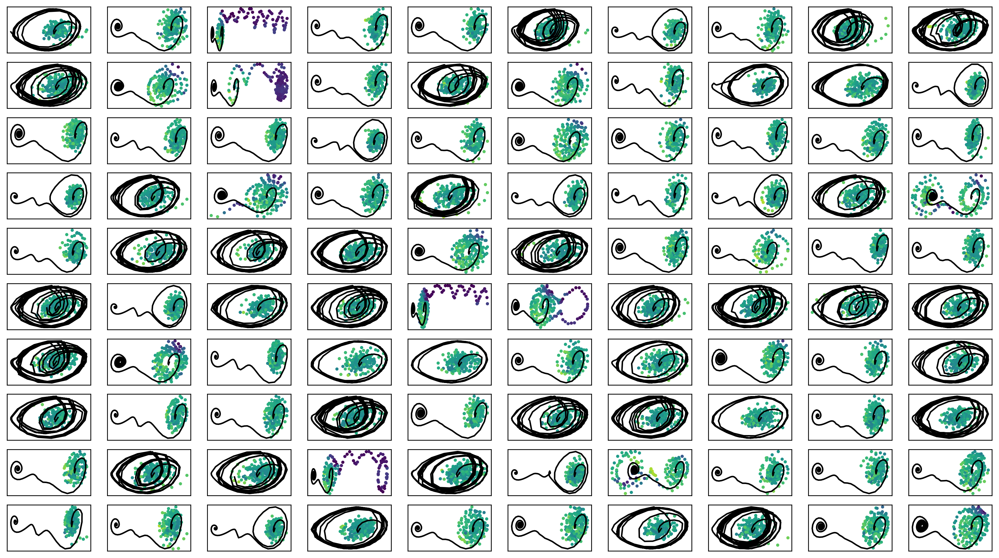

In [46]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [47]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -761.92307  validloss -660.77709±0.00000  bestvalidloss -660.77709  last_update 0
train: iter 1  trainloss -773.94395  validloss -646.73174±0.00000  bestvalidloss -660.77709  last_update 1
train: iter 2  trainloss -779.58414  validloss -661.18722±0.00000  bestvalidloss -661.18722  last_update 0
train: iter 3  trainloss -768.79168  validloss -687.90513±0.00000  bestvalidloss -687.90513  last_update 0
train: iter 4  trainloss -771.63553  validloss -668.78462±0.00000  bestvalidloss -687.90513  last_update 1
train: iter 5  trainloss -771.52058  validloss -674.94743±0.00000  bestvalidloss -687.90513  last_update 2
train: iter 6  trainloss -724.64369  validloss -682.40464±0.00000  bestvalidloss -687.90513  last_update 3
train: iter 7  trainloss -778.32802  validloss -665.47444±0.00000  bestvalidloss -687.90513  last_update 4
train: iter 8  trainloss -781.03379  validloss -681.90376±0.00000  bestvalidloss -687.90513  last_u

train: iter 76  trainloss -785.17400  validloss -650.82613±0.00000  bestvalidloss -716.77686  last_update 48
train: iter 77  trainloss -782.99882  validloss -701.62380±0.00000  bestvalidloss -716.77686  last_update 49
train: iter 78  trainloss -782.96912  validloss -683.14746±0.00000  bestvalidloss -716.77686  last_update 50
train: iter 79  trainloss -788.31399  validloss -655.33497±0.00000  bestvalidloss -716.77686  last_update 51
train: iter 80  trainloss -783.56948  validloss -659.36259±0.00000  bestvalidloss -716.77686  last_update 52
train: iter 81  trainloss -786.55544  validloss -640.46885±0.00000  bestvalidloss -716.77686  last_update 53
train: iter 82  trainloss -774.41342  validloss -652.87123±0.00000  bestvalidloss -716.77686  last_update 54
train: iter 83  trainloss -763.33408  validloss -687.84701±0.00000  bestvalidloss -716.77686  last_update 55
train: iter 84  trainloss -745.77420  validloss -703.22131±0.00000  bestvalidloss -716.77686  last_update 56
train: iter 85  tra

train: iter 151  trainloss -751.77617  validloss -645.98852±0.00000  bestvalidloss -718.04215  last_update 42
train: iter 152  trainloss -781.06589  validloss -670.79737±0.00000  bestvalidloss -718.04215  last_update 43
train: iter 153  trainloss -783.03344  validloss -658.74279±0.00000  bestvalidloss -718.04215  last_update 44
train: iter 154  trainloss -785.51758  validloss -667.73993±0.00000  bestvalidloss -718.04215  last_update 45
train: iter 155  trainloss -786.84897  validloss -650.17469±0.00000  bestvalidloss -718.04215  last_update 46
train: iter 156  trainloss -772.07539  validloss -657.66697±0.00000  bestvalidloss -718.04215  last_update 47
train: iter 157  trainloss -781.55660  validloss -703.40763±0.00000  bestvalidloss -718.04215  last_update 48
train: iter 158  trainloss -770.67996  validloss -676.93016±0.00000  bestvalidloss -718.04215  last_update 49
train: iter 159  trainloss -753.48472  validloss -694.01408±0.00000  bestvalidloss -718.04215  last_update 50
train: ite

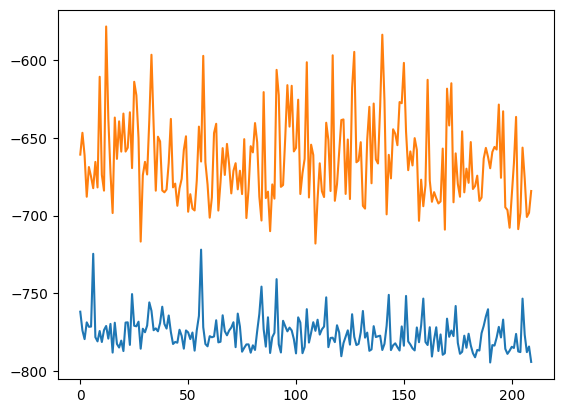

alpha 0.1 default_lr 0.0005


In [48]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

実環境方策rollout vs Sim環境方策rollout


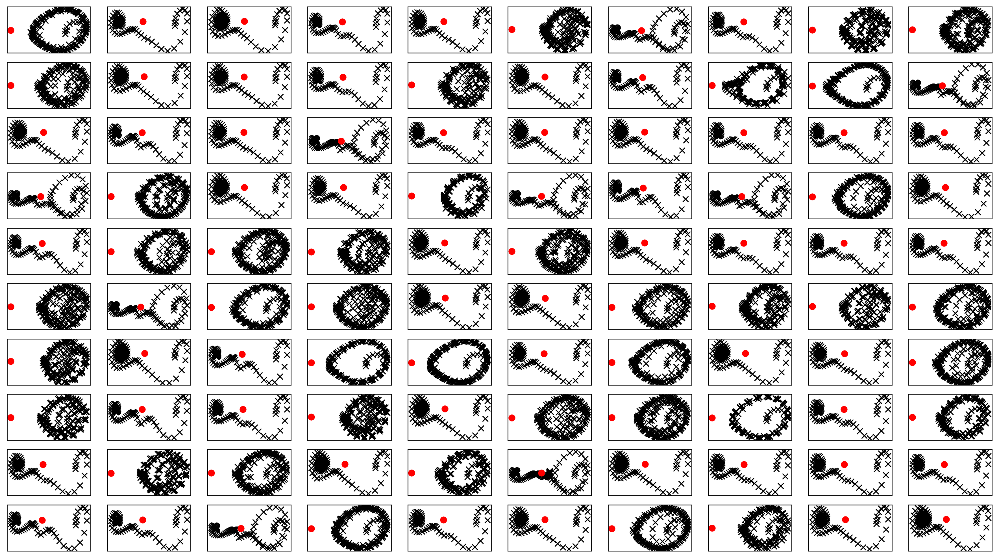

In [49]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
# plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

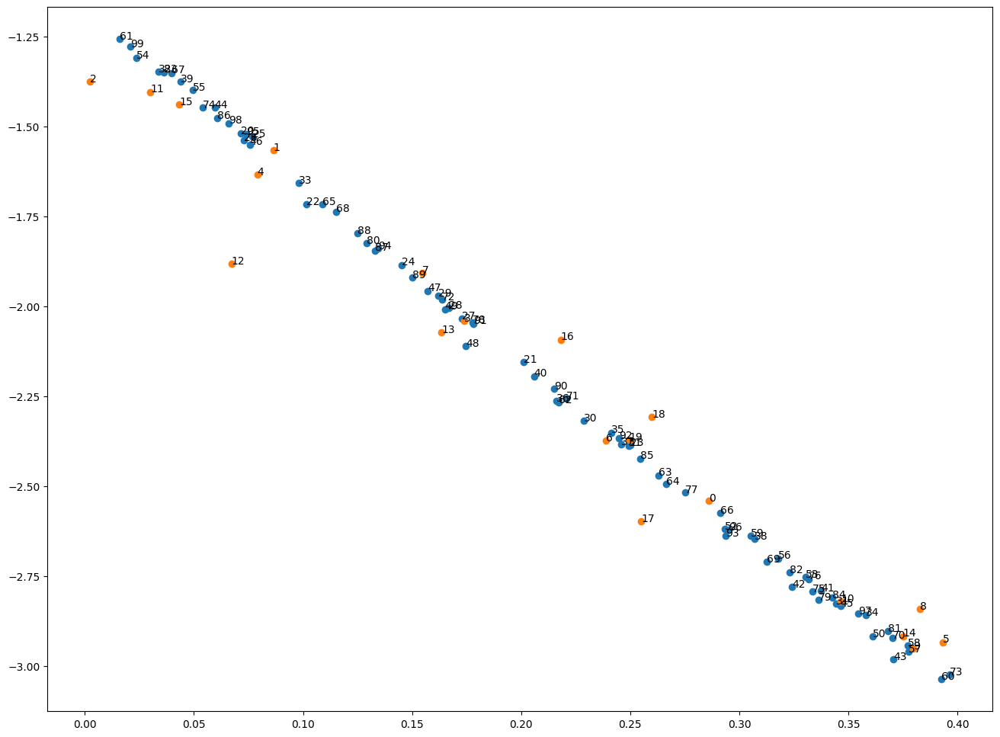

[0.2859264  0.0864358  0.0024921  0.17391661 0.07907403 0.39336027
 0.23893358 0.15462851 0.38266119 0.37959092]
[0.34651572 0.02997943 0.06718887 0.16337754 0.37502863 0.04327735
 0.21808106 0.2550441  0.25992204 0.24956645]
[0.07158956 0.20101322 0.10147186 0.24997234 0.14514144 0.07657856
 0.07297816 0.17272883 0.16671052 0.16193009]
[0.22885551 0.34440572 0.03386464 0.09818148 0.35786052 0.2414254
 0.21602989 0.24582514 0.30710321 0.04392725]
[0.20586148 0.3374828  0.32405777 0.37068828 0.05949074 0.34630997
 0.0756103  0.15711247 0.17470652 0.16498888]
[0.36096874 0.24942754 0.29319949 0.33040915 0.02355204 0.04960585
 0.31776933 0.377519   0.37703434 0.30519746]
[0.39248397 0.01603645 0.21731613 0.26299385 0.26662336 0.10898858
 0.29130778 0.03973111 0.11521473 0.31261245]
[0.37032344 0.22077058 0.16383656 0.39631873 0.05390104 0.33351255
 0.33176718 0.27528851 0.17781627 0.33618643]
[0.12902999 0.36799494 0.32301958 0.03636422 0.34247351 0.25473947
 0.06075424 0.13299807 0.12488

In [50]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [51]:
print(datetime.datetime.now())

2023-06-12 08:30:39.088896


# Iter 5

In [52]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1

 2

 3

 4
predict diverge [ -5.06807377 -20.57502644] [-1.02563515 -7.10213716] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 48

 5

 6

 7

 8

 9

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21
predict diverge [ -5.61928031 -24.71062241] [-1.15202372 -9.99166893] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 37

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69
predict diverge [ -6.2195268  -31.46872914] [ -1.1549291  -17.35582028] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 39

 70

 71

 72

 73

 74

 75

 76

 77

 78

 79

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92

 93

 94

 95

 96

 97

 98

 99
 


In [53]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 0.35987  validloss 0.33422±0.00000  bestvalidloss 0.33422  last_update 0
train: iter 1  trainloss 0.35394  validloss 0.31538±0.00000  bestvalidloss 0.31538  last_update 0
train: iter 2  trainloss 0.35163  validloss 0.31547±0.00000  bestvalidloss 0.31538  last_update 1
train: iter 3  trainloss 0.35096  validloss 0.31803±0.00000  bestvalidloss 0.31538  last_update 2
train: iter 4  trainloss 0.35028  validloss 0.31530±0.00000  bestvalidloss 0.31530  last_update 0
train: iter 5  trainloss 0.35097  validloss 0.32058±0.00000  bestvalidloss 0.31530  last_update 1
train: iter 6  trainloss 0.34989  validloss 0.31520±0.00000  bestvalidloss 0.31520  last_update 0
train: iter 7  trainloss 0.34965  validloss 0.31658±0.00000  bestvalidloss 0.31520  last_update 1
train: iter 8  trainloss 0.34814  validloss 0.31706±0.00000  bestvalidloss 0.31520  last_update 2
train: iter 9  trainloss 0.34850  validloss 0.32048±0.00000  bestvalidloss 0.31520  last_update 3
train: iter 10  trai

train: iter 83  trainloss 0.34209  validloss 0.31785±0.00000  bestvalidloss 0.31520  last_update 77
train: iter 84  trainloss 0.34132  validloss 0.32064±0.00000  bestvalidloss 0.31520  last_update 78
train: iter 85  trainloss 0.34211  validloss 0.31762±0.00000  bestvalidloss 0.31520  last_update 79
train: iter 86  trainloss 0.34157  validloss 0.32015±0.00000  bestvalidloss 0.31520  last_update 80
train: iter 87  trainloss 0.34140  validloss 0.31822±0.00000  bestvalidloss 0.31520  last_update 81
train: iter 88  trainloss 0.34151  validloss 0.31704±0.00000  bestvalidloss 0.31520  last_update 82
train: iter 89  trainloss 0.34195  validloss 0.32044±0.00000  bestvalidloss 0.31520  last_update 83
train: iter 90  trainloss 0.34132  validloss 0.31740±0.00000  bestvalidloss 0.31520  last_update 84
train: iter 91  trainloss 0.34101  validloss 0.31727±0.00000  bestvalidloss 0.31520  last_update 85
train: iter 92  trainloss 0.34140  validloss 0.31997±0.00000  bestvalidloss 0.31520  last_update 86


train: iter 165  trainloss 0.33890  validloss 0.31863±0.00000  bestvalidloss 0.31417  last_update 48
train: iter 166  trainloss 0.33858  validloss 0.31714±0.00000  bestvalidloss 0.31417  last_update 49
train: iter 167  trainloss 0.34044  validloss 0.31906±0.00000  bestvalidloss 0.31417  last_update 50
train: iter 168  trainloss 0.33928  validloss 0.31644±0.00000  bestvalidloss 0.31417  last_update 51
train: iter 169  trainloss 0.33882  validloss 0.31922±0.00000  bestvalidloss 0.31417  last_update 52
train: iter 170  trainloss 0.33815  validloss 0.31803±0.00000  bestvalidloss 0.31417  last_update 53
train: iter 171  trainloss 0.33827  validloss 0.31962±0.00000  bestvalidloss 0.31417  last_update 54
train: iter 172  trainloss 0.33837  validloss 0.31908±0.00000  bestvalidloss 0.31417  last_update 55
train: iter 173  trainloss 0.33864  validloss 0.31810±0.00000  bestvalidloss 0.31417  last_update 56
train: iter 174  trainloss 0.34008  validloss 0.31973±0.00000  bestvalidloss 0.31417  last_

train: iter 247  trainloss 0.33538  validloss 0.31953±0.00000  bestvalidloss 0.31334  last_update 29
train: iter 248  trainloss 0.33616  validloss 0.32126±0.00000  bestvalidloss 0.31334  last_update 30
train: iter 249  trainloss 0.33727  validloss 0.31622±0.00000  bestvalidloss 0.31334  last_update 31
train: iter 250  trainloss 0.33546  validloss 0.32125±0.00000  bestvalidloss 0.31334  last_update 32
train: iter 251  trainloss 0.33677  validloss 0.31768±0.00000  bestvalidloss 0.31334  last_update 33
train: iter 252  trainloss 0.33698  validloss 0.32306±0.00000  bestvalidloss 0.31334  last_update 34
train: iter 253  trainloss 0.33599  validloss 0.31940±0.00000  bestvalidloss 0.31334  last_update 35
train: iter 254  trainloss 0.33591  validloss 0.31599±0.00000  bestvalidloss 0.31334  last_update 36
train: iter 255  trainloss 0.33589  validloss 0.32027±0.00000  bestvalidloss 0.31334  last_update 37
train: iter 256  trainloss 0.33662  validloss 0.32155±0.00000  bestvalidloss 0.31334  last_

([0.359872904792428,
  0.3539445148780942,
  0.35162744354456665,
  0.3509596660733223,
  0.35028459709137677,
  0.3509706497192383,
  0.34988738764077426,
  0.3496503379195929,
  0.3481442487798631,
  0.348502997495234,
  0.34839947801083326,
  0.3484656995162368,
  0.3481981156393886,
  0.3469006948173046,
  0.347109611518681,
  0.3475851623341441,
  0.3474132750183344,
  0.3471343332901597,
  0.34690174348652364,
  0.347279417514801,
  0.3459178584627807,
  0.3474162120372057,
  0.3459693970158696,
  0.3466402949765325,
  0.3468664104118943,
  0.34560123616829513,
  0.3456579400226474,
  0.34653684142977,
  0.34566602017730474,
  0.3454307667911053,
  0.34685111017897724,
  0.34495857106521727,
  0.3454578768461943,
  0.34464318472892047,
  0.34592995792627335,
  0.3452795230783522,
  0.34517595879733565,
  0.3454852789640427,
  0.34585705026984215,
  0.3442554209381342,
  0.34394696271047,
  0.3443128628656268,
  0.3455358465202153,
  0.34393188524991275,
  0.3440721848979592,
  0.

In [54]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -2.527986497783661
valid_loss:  -2.1423894524574285
weight_alpha 1.0 h_min_tilde -6.1621227 ell_tilde -2.4508670887184145 kappa_tilde 0.0005190862975275937
train_loss:  -3.976214490127564
valid_loss:  -3.3496602571487424
weight_alpha 0.1 h_min_tilde -6.1621227 ell_tilde -3.8509036435317996 kappa_tilde 0.0006577781494337078


1e-08 1000.0


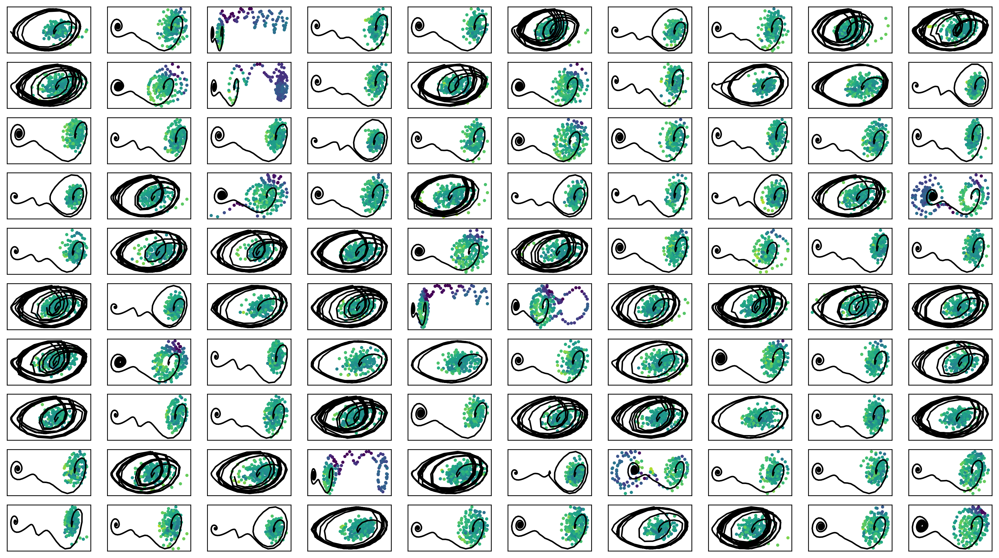

In [55]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [56]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

# train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
# iwvi.update_mulogvar_offlinedata()

# train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
# iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -766.30423  validloss -674.81711±0.00000  bestvalidloss -674.81711  last_update 0
train: iter 1  trainloss -792.17941  validloss -665.91089±0.00000  bestvalidloss -674.81711  last_update 1
train: iter 2  trainloss -777.13205  validloss -680.07332±0.00000  bestvalidloss -680.07332  last_update 0
train: iter 3  trainloss -776.48803  validloss -671.61406±0.00000  bestvalidloss -680.07332  last_update 1
train: iter 4  trainloss -789.27960  validloss -667.16606±0.00000  bestvalidloss -680.07332  last_update 2
train: iter 5  trainloss -754.82132  validloss -658.51527±0.00000  bestvalidloss -680.07332  last_update 3
train: iter 6  trainloss -789.50455  validloss -704.18809±0.00000  bestvalidloss -704.18809  last_update 0
train: iter 7  trainloss -780.29246  validloss -667.94648±0.00000  bestvalidloss -704.18809  last_update 1
train: iter 8  trainloss -781.18656  validloss -646.14163±0.00000  bestvalidloss -704.18809  last_u

train: iter 76  trainloss -778.74148  validloss -646.10372±0.00000  bestvalidloss -724.55464  last_update 25
train: iter 77  trainloss -791.14187  validloss -652.62152±0.00000  bestvalidloss -724.55464  last_update 26
train: iter 78  trainloss -791.68773  validloss -667.65347±0.00000  bestvalidloss -724.55464  last_update 27
train: iter 79  trainloss -775.03155  validloss -674.44410±0.00000  bestvalidloss -724.55464  last_update 28
train: iter 80  trainloss -787.46696  validloss -682.09757±0.00000  bestvalidloss -724.55464  last_update 29
train: iter 81  trainloss -756.14217  validloss -668.46077±0.00000  bestvalidloss -724.55464  last_update 30
train: iter 82  trainloss -790.62380  validloss -681.46485±0.00000  bestvalidloss -724.55464  last_update 31
train: iter 83  trainloss -782.59387  validloss -680.86139±0.00000  bestvalidloss -724.55464  last_update 32
train: iter 84  trainloss -775.15147  validloss -665.18006±0.00000  bestvalidloss -724.55464  last_update 33
train: iter 85  tra

train: iter 151  trainloss -789.26879  validloss -679.93013±0.00000  bestvalidloss -724.55464  last_update 100
train: fin
penalty_target_min tensor(-6.1621) penalty_target_max tensor(33.6610)


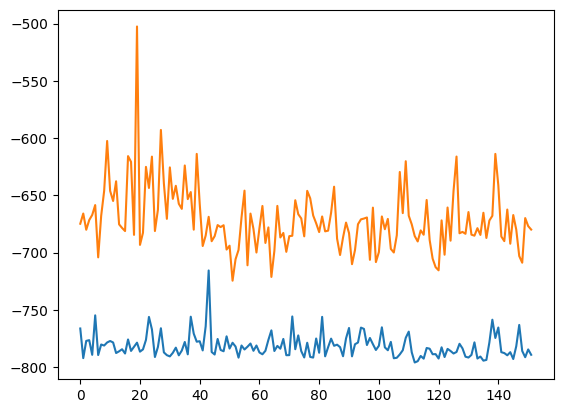

alpha 0.1 default_lr 0.0005


In [57]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

# plt.plot(train_curve2)
# plt.plot(valid_curve2)
# plt.show()

# plt.plot(train_curve3)
# plt.plot(valid_curve3)
# plt.show()
print("alpha",alpha, "default_lr", default_lr)

実環境方策rollout vs Sim環境方策rollout


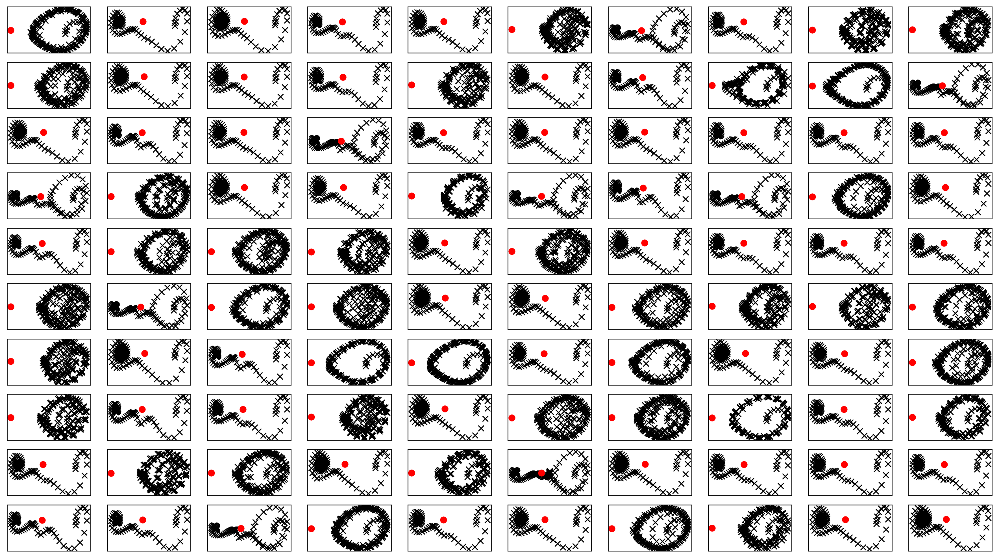

In [58]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
#     ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
#     ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
    ax_list[-1].plot(0, 0,"ro") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
# plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

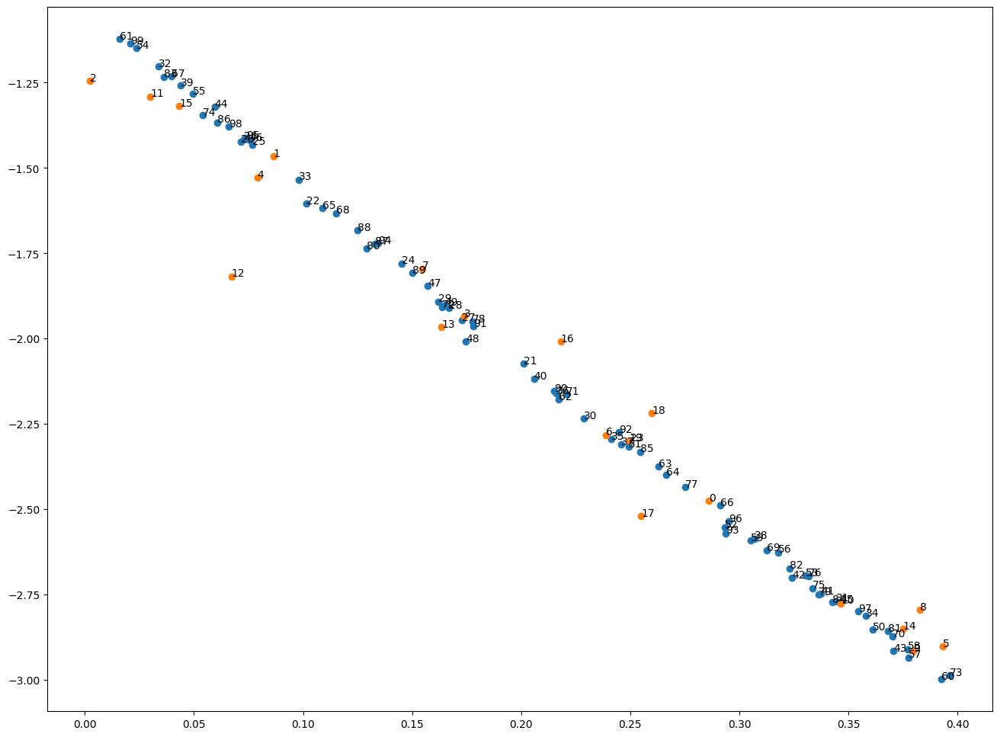

[0.2859264  0.0864358  0.0024921  0.17391661 0.07907403 0.39336027
 0.23893358 0.15462851 0.38266119 0.37959092]
[0.34651572 0.02997943 0.06718887 0.16337754 0.37502863 0.04327735
 0.21808106 0.2550441  0.25992204 0.24956645]
[0.07158956 0.20101322 0.10147186 0.24997234 0.14514144 0.07657856
 0.07297816 0.17272883 0.16671052 0.16193009]
[0.22885551 0.34440572 0.03386464 0.09818148 0.35786052 0.2414254
 0.21602989 0.24582514 0.30710321 0.04392725]
[0.20586148 0.3374828  0.32405777 0.37068828 0.05949074 0.34630997
 0.0756103  0.15711247 0.17470652 0.16498888]
[0.36096874 0.24942754 0.29319949 0.33040915 0.02355204 0.04960585
 0.31776933 0.377519   0.37703434 0.30519746]
[0.39248397 0.01603645 0.21731613 0.26299385 0.26662336 0.10898858
 0.29130778 0.03973111 0.11521473 0.31261245]
[0.37032344 0.22077058 0.16383656 0.39631873 0.05390104 0.33351255
 0.33176718 0.27528851 0.17781627 0.33618643]
[0.12902999 0.36799494 0.32301958 0.03636422 0.34247351 0.25473947
 0.06075424 0.13299807 0.12488

In [59]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# 評価関数計算

In [60]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0
predict diverge [ -4.57430321 -36.82600097] [ -1.33991163 -22.6768681 ] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 33

 1

 2

 3

 4

 5

 6

 7

 8

 9
predict diverge [-2.96117889 37.80023009] [ 0.67079089 25.86922705] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 40

 10

 11

 12

 13

 14

 15

 16

 17

 18

 19

 20

 21

 22

 23

 24

 25

 26

 27

 28

 29

 30

 31

 32

 33

 34
predict diverge [ -6.63333773 -34.74946459] [ -1.23530843 -19.64394916] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 50

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57
predict diverge [-5.14628918 26.29415277] [ 1.23149454 13.0640387 ] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 89

 58

 59
predict diverge [ -3.76449063 -30.90005288] [ -1.09640515 -20.57800407] [91.57898 20.     ] [45.78949 10.     ] sim_timestep 39

 60

 61

 62

 63

 64

 65

 66

 67

 68

 69

 70

 71

 72

 73

 74

 7

In [61]:
iwvi.train_ratio(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early, policy=agent.select_action)


train: iter 0  trainloss 0.35370  validloss 0.35511±0.00000  bestvalidloss 0.35511  last_update 0
train: iter 1  trainloss 0.34717  validloss 0.34491±0.00000  bestvalidloss 0.34491  last_update 0
train: iter 2  trainloss 0.34352  validloss 0.34452±0.00000  bestvalidloss 0.34452  last_update 0
train: iter 3  trainloss 0.34392  validloss 0.34176±0.00000  bestvalidloss 0.34176  last_update 0
train: iter 4  trainloss 0.34271  validloss 0.34238±0.00000  bestvalidloss 0.34176  last_update 1
train: iter 5  trainloss 0.34275  validloss 0.34643±0.00000  bestvalidloss 0.34176  last_update 2
train: iter 6  trainloss 0.34197  validloss 0.34400±0.00000  bestvalidloss 0.34176  last_update 3
train: iter 7  trainloss 0.34307  validloss 0.34176±0.00000  bestvalidloss 0.34176  last_update 4
train: iter 8  trainloss 0.34203  validloss 0.34263±0.00000  bestvalidloss 0.34176  last_update 5
train: iter 9  trainloss 0.34142  validloss 0.34208±0.00000  bestvalidloss 0.34176  last_update 6
train: iter 10  trai

train: iter 83  trainloss 0.33558  validloss 0.33959±0.00000  bestvalidloss 0.33839  last_update 3
train: iter 84  trainloss 0.33468  validloss 0.33879±0.00000  bestvalidloss 0.33839  last_update 4
train: iter 85  trainloss 0.33474  validloss 0.34002±0.00000  bestvalidloss 0.33839  last_update 5
train: iter 86  trainloss 0.33554  validloss 0.33988±0.00000  bestvalidloss 0.33839  last_update 6
train: iter 87  trainloss 0.33538  validloss 0.34271±0.00000  bestvalidloss 0.33839  last_update 7
train: iter 88  trainloss 0.33455  validloss 0.33877±0.00000  bestvalidloss 0.33839  last_update 8
train: iter 89  trainloss 0.33672  validloss 0.34315±0.00000  bestvalidloss 0.33839  last_update 9
train: iter 90  trainloss 0.33559  validloss 0.34000±0.00000  bestvalidloss 0.33839  last_update 10
train: iter 91  trainloss 0.33523  validloss 0.34226±0.00000  bestvalidloss 0.33839  last_update 11
train: iter 92  trainloss 0.33634  validloss 0.33861±0.00000  bestvalidloss 0.33839  last_update 12
train: 

train: iter 165  trainloss 0.33239  validloss 0.33907±0.00000  bestvalidloss 0.33757  last_update 36
train: iter 166  trainloss 0.33151  validloss 0.33784±0.00000  bestvalidloss 0.33757  last_update 37
train: iter 167  trainloss 0.33250  validloss 0.34349±0.00000  bestvalidloss 0.33757  last_update 38
train: iter 168  trainloss 0.33247  validloss 0.33969±0.00000  bestvalidloss 0.33757  last_update 39
train: iter 169  trainloss 0.33257  validloss 0.34227±0.00000  bestvalidloss 0.33757  last_update 40
train: iter 170  trainloss 0.33248  validloss 0.33892±0.00000  bestvalidloss 0.33757  last_update 41
train: iter 171  trainloss 0.33190  validloss 0.33766±0.00000  bestvalidloss 0.33757  last_update 42
train: iter 172  trainloss 0.33200  validloss 0.33800±0.00000  bestvalidloss 0.33757  last_update 43
train: iter 173  trainloss 0.33248  validloss 0.33968±0.00000  bestvalidloss 0.33757  last_update 44
train: iter 174  trainloss 0.33221  validloss 0.34080±0.00000  bestvalidloss 0.33757  last_

train: iter 247  trainloss 0.33050  validloss 0.33931±0.00000  bestvalidloss 0.33750  last_update 68
train: iter 248  trainloss 0.32958  validloss 0.33833±0.00000  bestvalidloss 0.33750  last_update 69
train: iter 249  trainloss 0.33018  validloss 0.33974±0.00000  bestvalidloss 0.33750  last_update 70
train: iter 250  trainloss 0.32991  validloss 0.34004±0.00000  bestvalidloss 0.33750  last_update 71
train: iter 251  trainloss 0.32959  validloss 0.33860±0.00000  bestvalidloss 0.33750  last_update 72
train: iter 252  trainloss 0.33013  validloss 0.33794±0.00000  bestvalidloss 0.33750  last_update 73
train: iter 253  trainloss 0.32961  validloss 0.34143±0.00000  bestvalidloss 0.33750  last_update 74
train: iter 254  trainloss 0.33189  validloss 0.33863±0.00000  bestvalidloss 0.33750  last_update 75
train: iter 255  trainloss 0.33039  validloss 0.33768±0.00000  bestvalidloss 0.33750  last_update 76
train: iter 256  trainloss 0.33045  validloss 0.33890±0.00000  bestvalidloss 0.33750  last_

([0.35369698889553547,
  0.3471695311367512,
  0.34351626243442296,
  0.34392461460083723,
  0.342710779607296,
  0.3427521973848343,
  0.34196588676422834,
  0.34307378642261027,
  0.3420251652598381,
  0.3414199700579047,
  0.34132874943315983,
  0.34084448162466285,
  0.34110516756772996,
  0.3412314048036933,
  0.34004620984196665,
  0.33996516559273005,
  0.3397230299189687,
  0.3402325725182891,
  0.3397546285763383,
  0.33907654881477356,
  0.33864588756114244,
  0.3393533883616328,
  0.34064464159309865,
  0.34063283577561376,
  0.3382977981120348,
  0.3390975587069988,
  0.3390080854296684,
  0.33882336392998696,
  0.3397114794701338,
  0.3388983473181725,
  0.3379794146865606,
  0.33860998284071686,
  0.337147724442184,
  0.33868072349578143,
  0.33762064967304467,
  0.33793695252388717,
  0.33739374913275244,
  0.33772346656769514,
  0.33773444723337886,
  0.3366751765832305,
  0.3389169616624713,
  0.3367239968851209,
  0.3362259006127715,
  0.337617726624012,
  0.337448087

In [62]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -2.4982845848083493
valid_loss:  -2.1838625053763385
weight_alpha 1.0 h_min_tilde -6.1621222 ell_tilde -2.435400168921947 kappa_tilde 0.0005180080355125993
train_loss:  -3.9642149509429934
valid_loss:  -3.389772936630249
weight_alpha 0.1 h_min_tilde -6.1621222 ell_tilde -3.8493265480804446 kappa_tilde 0.0006575539095507278


1e-08 1000.0


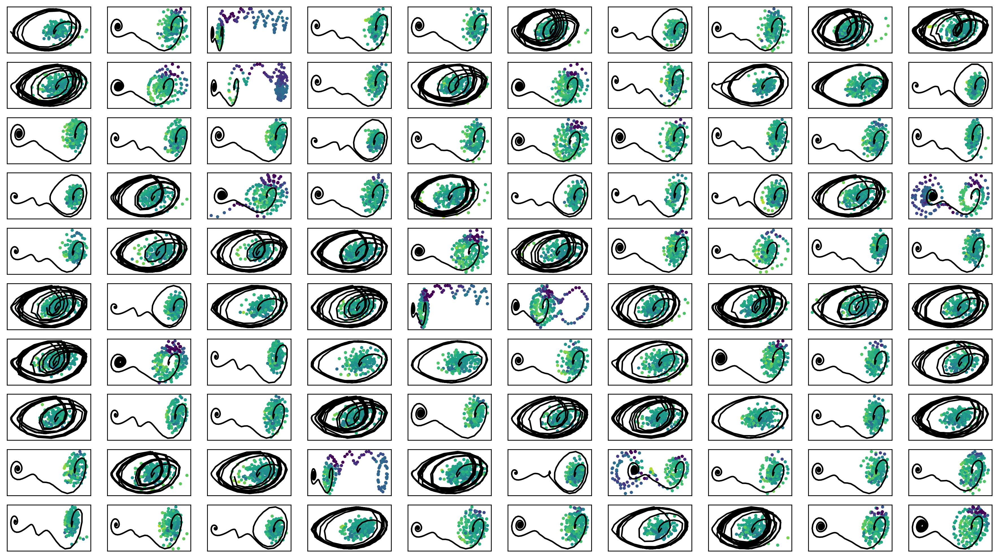

In [63]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter6.png")

In [64]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=default_early)


train: iter 0  trainloss 7.72317  validloss 8.07781±0.00000  bestvalidloss 8.07781  last_update 0
train: iter 1  trainloss 6.97423  validloss 7.29777±0.00000  bestvalidloss 7.29777  last_update 0
train: iter 2  trainloss 6.32928  validloss 6.59046±0.00000  bestvalidloss 6.59046  last_update 0
train: iter 3  trainloss 5.78356  validloss 6.00429±0.00000  bestvalidloss 6.00429  last_update 0
train: iter 4  trainloss 5.32377  validloss 5.52105±0.00000  bestvalidloss 5.52105  last_update 0
train: iter 5  trainloss 4.93269  validloss 5.07729±0.00000  bestvalidloss 5.07729  last_update 0
train: iter 6  trainloss 4.57988  validloss 4.71392±0.00000  bestvalidloss 4.71392  last_update 0
train: iter 7  trainloss 4.27676  validloss 4.38804±0.00000  bestvalidloss 4.38804  last_update 0
train: iter 8  trainloss 4.00805  validloss 4.10229±0.00000  bestvalidloss 4.10229  last_update 0
train: iter 9  trainloss 3.77893  validloss 3.86713±0.00000  bestvalidloss 3.86713  last_update 0
train: iter 10  trai

train: iter 91  trainloss 0.85968  validloss 0.84083±0.00000  bestvalidloss 0.83441  last_update 2
train: iter 92  trainloss 0.85973  validloss 0.84790±0.00000  bestvalidloss 0.83441  last_update 3
train: iter 93  trainloss 0.85934  validloss 0.82864±0.00000  bestvalidloss 0.82864  last_update 0
train: iter 94  trainloss 0.86237  validloss 0.83612±0.00000  bestvalidloss 0.82864  last_update 1
train: iter 95  trainloss 0.86077  validloss 0.83335±0.00000  bestvalidloss 0.82864  last_update 2
train: iter 96  trainloss 0.85647  validloss 0.85370±0.00000  bestvalidloss 0.82864  last_update 3
train: iter 97  trainloss 0.85328  validloss 0.82638±0.00000  bestvalidloss 0.82638  last_update 0
train: iter 98  trainloss 0.86340  validloss 0.83275±0.00000  bestvalidloss 0.82638  last_update 1
train: iter 99  trainloss 0.86243  validloss 0.84021±0.00000  bestvalidloss 0.82638  last_update 2
train: iter 100  trainloss 0.85697  validloss 0.83086±0.00000  bestvalidloss 0.82638  last_update 3
train: it

train: iter 186  trainloss 0.85047  validloss 0.81996±0.00000  bestvalidloss 0.81446  last_update 72
train: iter 187  trainloss 0.85334  validloss 0.83998±0.00000  bestvalidloss 0.81446  last_update 73
train: iter 188  trainloss 0.86162  validloss 0.84058±0.00000  bestvalidloss 0.81446  last_update 74
train: iter 189  trainloss 0.85688  validloss 0.83455±0.00000  bestvalidloss 0.81446  last_update 75
train: iter 190  trainloss 0.85441  validloss 0.83288±0.00000  bestvalidloss 0.81446  last_update 76
train: iter 191  trainloss 0.85129  validloss 0.83688±0.00000  bestvalidloss 0.81446  last_update 77
train: iter 192  trainloss 0.84853  validloss 0.84252±0.00000  bestvalidloss 0.81446  last_update 78
train: iter 193  trainloss 0.85120  validloss 0.83976±0.00000  bestvalidloss 0.81446  last_update 79
train: iter 194  trainloss 0.85486  validloss 0.83257±0.00000  bestvalidloss 0.81446  last_update 80
train: iter 195  trainloss 0.85838  validloss 0.83420±0.00000  bestvalidloss 0.81446  last_

train: iter 279  trainloss 0.85406  validloss 0.82033±0.00000  bestvalidloss 0.81126  last_update 71
train: iter 280  trainloss 0.85326  validloss 0.82027±0.00000  bestvalidloss 0.81126  last_update 72
train: iter 281  trainloss 0.85136  validloss 0.83307±0.00000  bestvalidloss 0.81126  last_update 73
train: iter 282  trainloss 0.85075  validloss 0.83602±0.00000  bestvalidloss 0.81126  last_update 74
train: iter 283  trainloss 0.85821  validloss 0.83788±0.00000  bestvalidloss 0.81126  last_update 75
train: iter 284  trainloss 0.85577  validloss 0.82653±0.00000  bestvalidloss 0.81126  last_update 76
train: iter 285  trainloss 0.84936  validloss 0.83805±0.00000  bestvalidloss 0.81126  last_update 77
train: iter 286  trainloss 0.85422  validloss 0.83974±0.00000  bestvalidloss 0.81126  last_update 78
train: iter 287  trainloss 0.85940  validloss 0.82392±0.00000  bestvalidloss 0.81126  last_update 79
train: iter 288  trainloss 0.85745  validloss 0.84757±0.00000  bestvalidloss 0.81126  last_

In [65]:
print(iwvi.initial_belief)


Parameter containing:
tensor([-2.1137, -1.1298], requires_grad=True)


In [66]:
train_curve, valid_curve = iwvi.train_penalty(num_iter=num_iter_max, lr=default_lr, early_stop_step=default_early)

train: iter 0  trainloss 22.05995  validloss 48.06910±0.00000  bestvalidloss 48.06910  last_update 0
train: iter 1  trainloss 3.40459  validloss 9.41904±0.00000  bestvalidloss 9.41904  last_update 0
train: iter 2  trainloss 1.64517  validloss 7.76096±0.00000  bestvalidloss 7.76096  last_update 0
train: iter 3  trainloss 1.15722  validloss 7.54247±0.00000  bestvalidloss 7.54247  last_update 0
train: iter 4  trainloss 0.98777  validloss 7.69857±0.00000  bestvalidloss 7.54247  last_update 1
train: iter 5  trainloss 0.89702  validloss 7.62335±0.00000  bestvalidloss 7.54247  last_update 2
train: iter 6  trainloss 0.86896  validloss 7.72765±0.00000  bestvalidloss 7.54247  last_update 3
train: iter 7  trainloss 0.83833  validloss 7.28473±0.00000  bestvalidloss 7.28473  last_update 0
train: iter 8  trainloss 0.82539  validloss 7.63400±0.00000  bestvalidloss 7.28473  last_update 1
train: iter 9  trainloss 0.81977  validloss 7.59832±0.00000  bestvalidloss 7.28473  last_update 2
train: iter 10  t

train: iter 83  trainloss 0.69583  validloss 7.84732±0.00000  bestvalidloss 6.45351  last_update 36
train: iter 84  trainloss 0.71940  validloss 7.65483±0.00000  bestvalidloss 6.45351  last_update 37
train: iter 85  trainloss 0.71478  validloss 7.08186±0.00000  bestvalidloss 6.45351  last_update 38
train: iter 86  trainloss 0.74055  validloss 7.46778±0.00000  bestvalidloss 6.45351  last_update 39
train: iter 87  trainloss 0.69597  validloss 7.94322±0.00000  bestvalidloss 6.45351  last_update 40
train: iter 88  trainloss 0.72554  validloss 8.61045±0.00000  bestvalidloss 6.45351  last_update 41
train: iter 89  trainloss 0.71174  validloss 7.43232±0.00000  bestvalidloss 6.45351  last_update 42
train: iter 90  trainloss 0.70309  validloss 7.85164±0.00000  bestvalidloss 6.45351  last_update 43
train: iter 91  trainloss 0.71253  validloss 8.88844±0.00000  bestvalidloss 6.45351  last_update 44
train: iter 92  trainloss 0.70022  validloss 8.09284±0.00000  bestvalidloss 6.45351  last_update 45


In [67]:
iwvi.save(ckpt_key="policy_optimization_iter1")

iwvi save ckpt1, ckpt2 ckpt_iwvi_basepartpendulum_policy_optimization_iter1 ckpt_iwvi_pendulum_policy_optimization_iter1
base save ckpt ckpt_basevi_pendulum_policy_optimization_iter1
base load self.initial_belief.data.sum() tensor(-3.2435)
base load dec.state_dict()['net_phat.0.weight'].sum() tensor(4.3682)


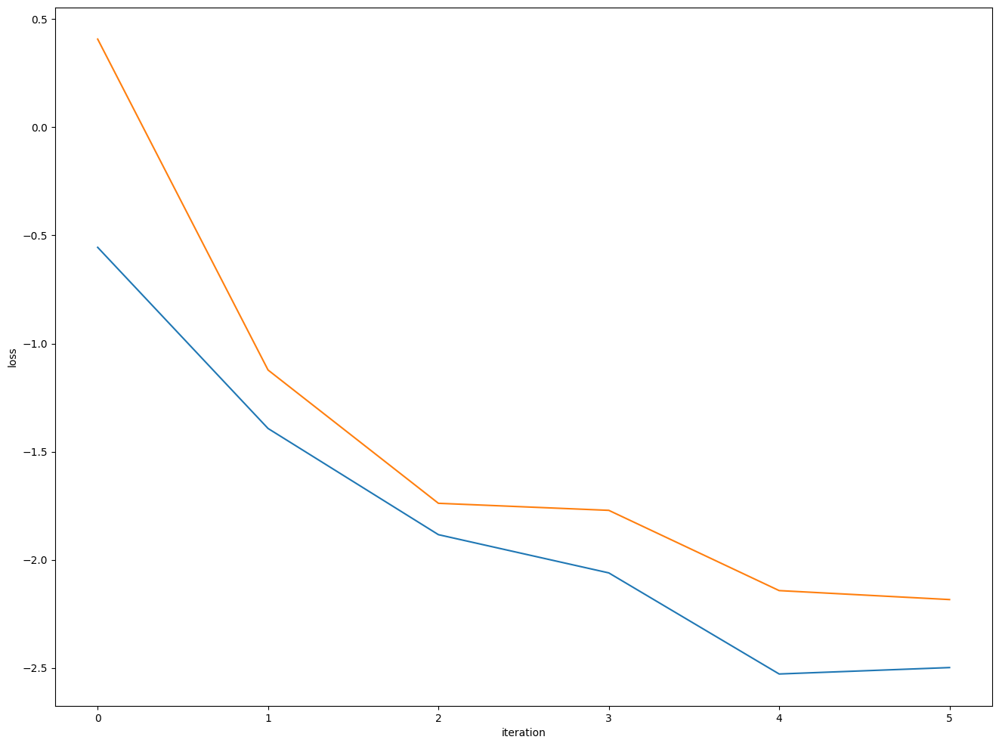

In [71]:
loss_array = np.array(loss_list)
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.plot(loss_array[:,1])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"learning_curve.png")
plt.savefig(figfilenamehead+"learning_curve.eps")
# plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

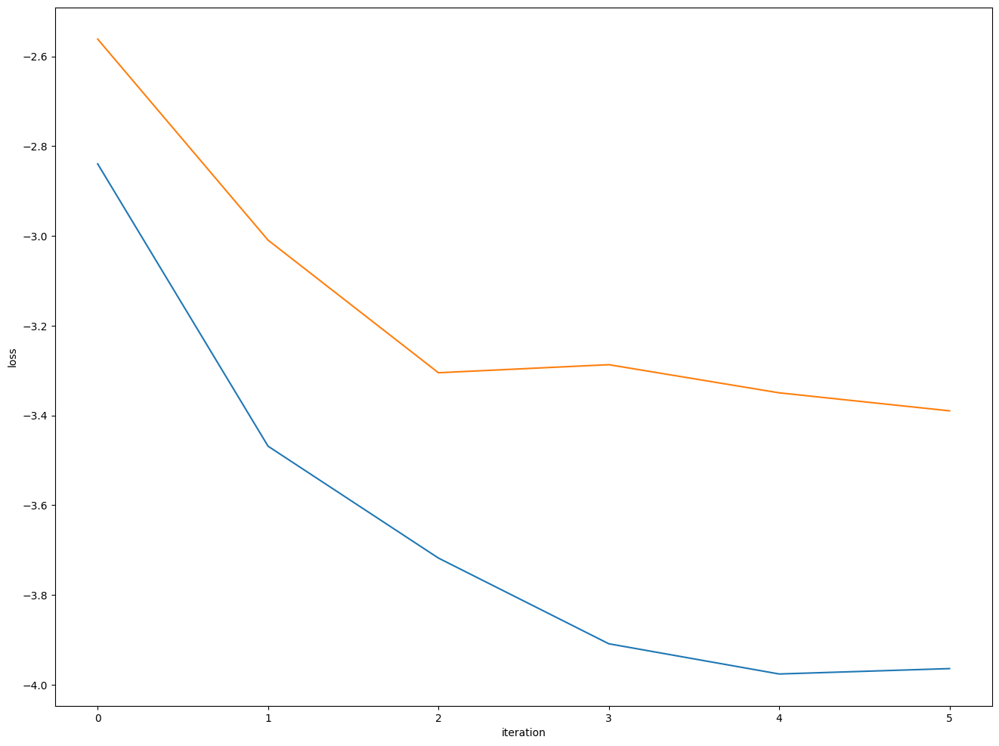

In [70]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.plot(normalized_loss_array[:,1])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"learning_curve_normalized_"+env_str+".png")
plt.savefig(figfilenamehead+"learning_curve_normalized_"+env_str+".eps")